In [43]:
import os
import sys
import glob
import uproot
import numpy as np
import matplotlib.pyplot as plt

from datetime import datetime

from scipy.signal import savgol_filter

from functools import partial

from matplotlib.colors import LogNorm

In [2]:
### Import functions from peak_functions

repository_path = os.path.abspath('../..')
sys.path.append(repository_path)

import blr_functions  as blr
import peak_functions as pf
import fit_functions  as fitf

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
plt.rcParams["figure.figsize"] = 8, 5
plt.rcParams["font.size"]      = 11

In [50]:
import re

evts_path = '/Users/romoluque_c/LEGEND/BACON/new_setup/data_npz_run3/'

all_chs = range(13)

def extract_date_obj_and_number(filename):
    match       = re.search(r"(\d{2}_\d{2}_\d{4})-file_(\d+)", filename)
    date_str    = match.group(1)
    file_number = int(match.group(2))
    date_obj    = datetime.strptime(date_str, "%m_%d_%Y")
    return date_obj, file_number

def extract_date_and_number(filename):
    match = re.search(r"(\d{2}_\d{2}_\d{4})-file_(\d+)", filename)
    return match.group(1), int(match.group(2))

files        = glob.glob(evts_path + 'BACoN_data_basic_info_run*.npz')
sorted_files = sorted(files, key=extract_date_obj_and_number)

In [52]:
sorted_files;

In [53]:
bsl_mean_i_dict = {}
bsl_mode_i_dict = {}
bsl_mean_f_dict = {}
bsl_mode_f_dict = {}
std_all_dict    = {}
max_all_dict    = {}

all_chs = range(13)

for filename in sorted_files:
    d       = np.load(filename, allow_pickle=True)
    date, _ = extract_date_and_number(filename)
    
    if date not in bsl_mean_i_dict:
        print(date)
        bsl_mean_i_dict[date] = {ch: d['bsl_mean_i_dict'].item()[ch] for ch in all_chs}
        bsl_mode_i_dict[date] = {ch: d['bsl_mode_i_dict'].item()[ch] for ch in all_chs}
        bsl_mean_f_dict[date] = {ch: d['bsl_mean_f_dict'].item()[ch] for ch in all_chs}
        bsl_mode_f_dict[date] = {ch: d['bsl_mode_f_dict'].item()[ch] for ch in all_chs}
        std_all_dict   [date] = {ch: d['std_all_dict']   .item()[ch] for ch in all_chs}
        max_all_dict   [date] = {ch: d['max_all_dict']   .item()[ch] for ch in all_chs}
        continue

    for ch in all_chs:
        try:
            bsl_mean_i_dict[date][ch] = np.concatenate((bsl_mean_i_dict[date][ch], d['bsl_mean_i_dict'].item()[ch]))
            bsl_mode_i_dict[date][ch] = np.concatenate((bsl_mode_i_dict[date][ch], d['bsl_mode_i_dict'].item()[ch]))
            bsl_mean_f_dict[date][ch] = np.concatenate((bsl_mean_f_dict[date][ch], d['bsl_mean_f_dict'].item()[ch]))
            bsl_mode_f_dict[date][ch] = np.concatenate((bsl_mode_f_dict[date][ch], d['bsl_mode_f_dict'].item()[ch]))
            std_all_dict   [date][ch] = np.concatenate((std_all_dict   [date][ch], d['std_all_dict']   .item()[ch]))
            max_all_dict   [date][ch] = np.concatenate((max_all_dict   [date][ch], d['max_all_dict']   .item()[ch]))
        
        except Exception as e:
            print(date, fnum, filename, ch, str(e))
            continue

09_08_2024
09_09_2024
09_10_2024
09_11_2024
09_12_2024
09_20_2024
09_25_2024
09_28_2024
10_04_2024
10_11_2024
10_17_2024
10_25_2024
11_01_2024
11_11_2024
11_25_2024
12_13_2024
12_21_2024
01_02_2025


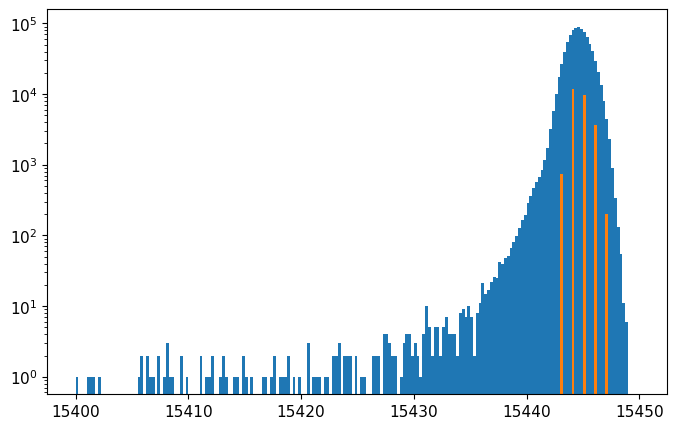

In [54]:
pmt_ch = 12
plt.hist(bsl_mean_i_dict['09_08_2024'][pmt_ch], bins=200, range=(15400, 15450), log=True);
plt.hist(bsl_mode_i_dict['09_08_2024'][pmt_ch], bins=200, range=(15400, 15450), log=True);

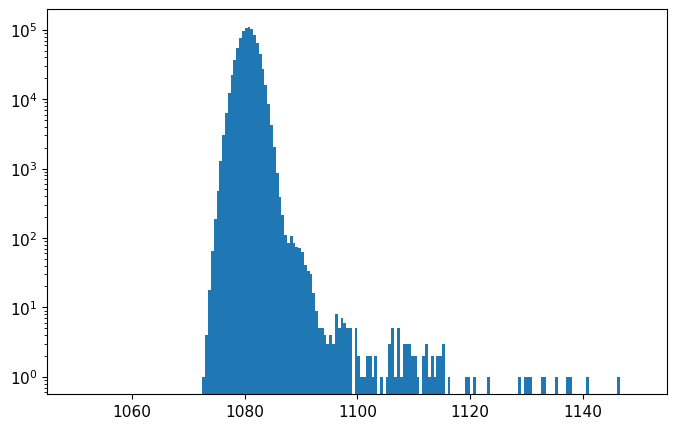

In [55]:
sipm_ch = 0
plt.hist(bsl_mean_i_dict['09_08_2024'][sipm_ch], bins=200, range=(1050, 1150), log=True);
#plt.hist(bsl_mode_i_dict['09_08_2024'][sipm_ch], bins=len(np.unique(bsl_mode_i_dict['09_08_2024'][sipm_ch])), range=(1000, 1200), log=True, alpha=0.5);

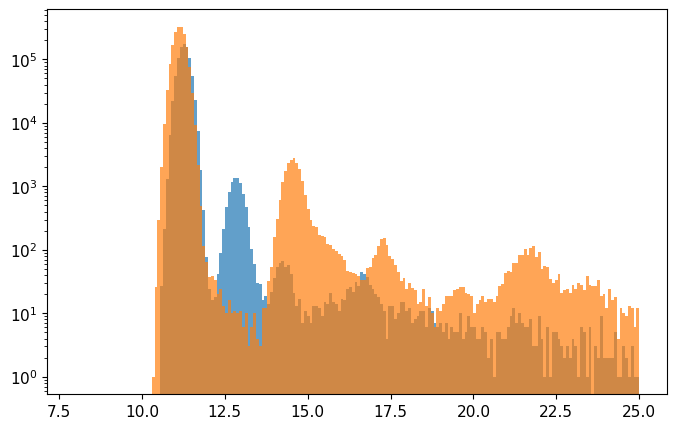

In [56]:
sipm_ch = 0
plt.hist(std_all_dict['09_08_2024'][sipm_ch], bins=200, range=(8, 25), log=True, alpha=0.7);
plt.hist(std_all_dict['10_04_2024'][sipm_ch], bins=200, range=(8, 25), log=True, alpha=0.7);

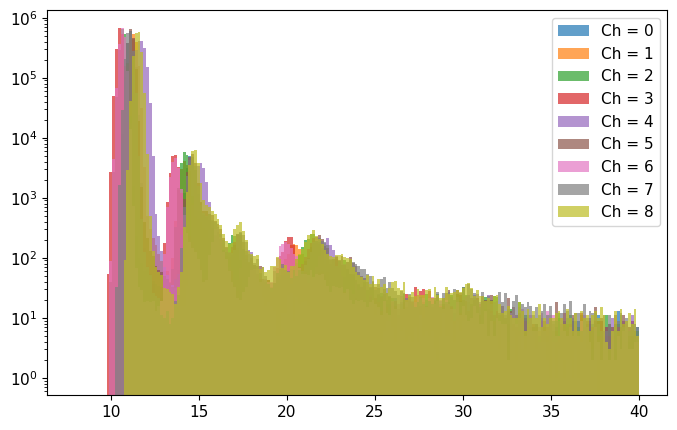

In [57]:
for sipm_ch in range(9):
    plt.hist(std_all_dict['10_04_2024'][sipm_ch], bins=200, range=(8, 40), log=True, alpha=0.7, label=f'Ch = {sipm_ch}')
plt.legend()

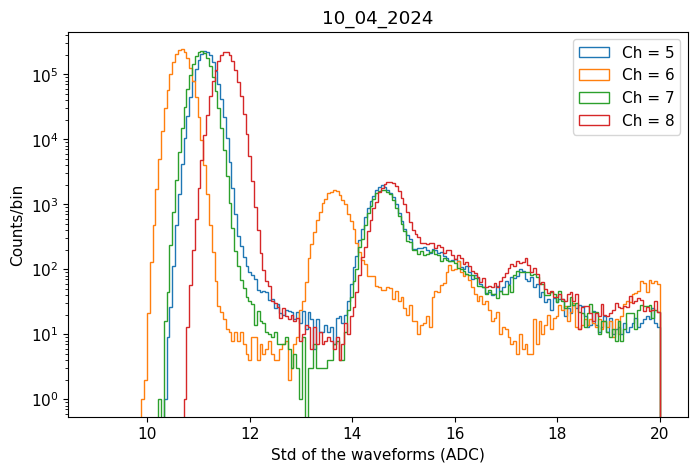

In [58]:
sel_date = '10_04_2024'
for sipm_ch in [5, 6, 7, 8]:
    plt.hist(std_all_dict[sel_date][sipm_ch], bins=200, range=(9, 20), label=f'Ch = {sipm_ch}', histtype='step', log=True)
plt.legend()
plt.title(sel_date)
plt.xlabel('Std of the waveforms (ADC)')
plt.ylabel('Counts/bin')
plt.show()

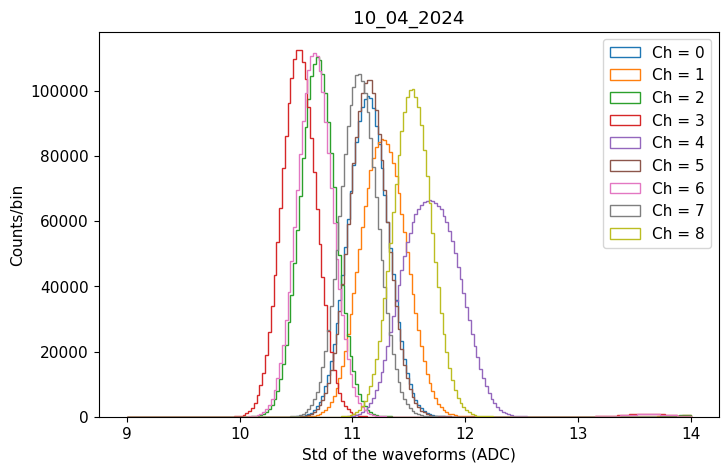

In [59]:
sel_date = '10_04_2024'
for sipm_ch in range(9):
    plt.hist(std_all_dict[sel_date][sipm_ch], bins=200, range=(9, 14), label=f'Ch = {sipm_ch}', histtype='step')
plt.legend()
plt.title(sel_date)
plt.xlabel('Std of the waveforms (ADC)')
plt.ylabel('Counts/bin')
plt.show()

In [62]:
std_all_dict.keys()

dict_keys(['09_08_2024', '09_09_2024', '09_10_2024', '09_11_2024', '09_12_2024', '09_20_2024', '09_25_2024', '09_28_2024', '10_04_2024', '10_11_2024', '10_17_2024', '10_25_2024', '11_01_2024', '11_11_2024', '11_25_2024', '12_13_2024', '12_21_2024', '01_02_2025'])

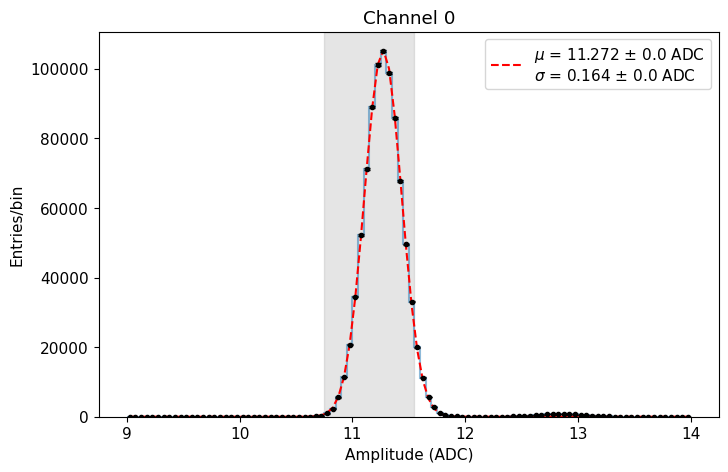

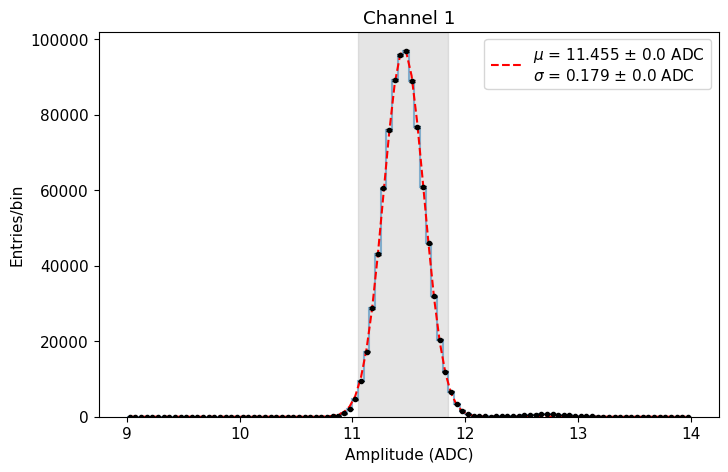

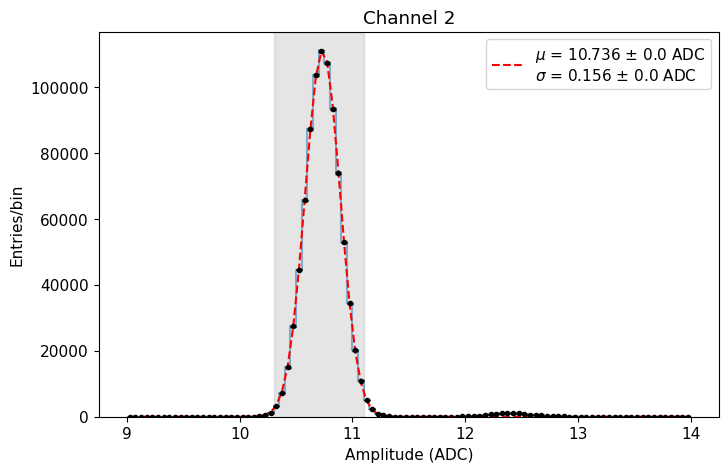

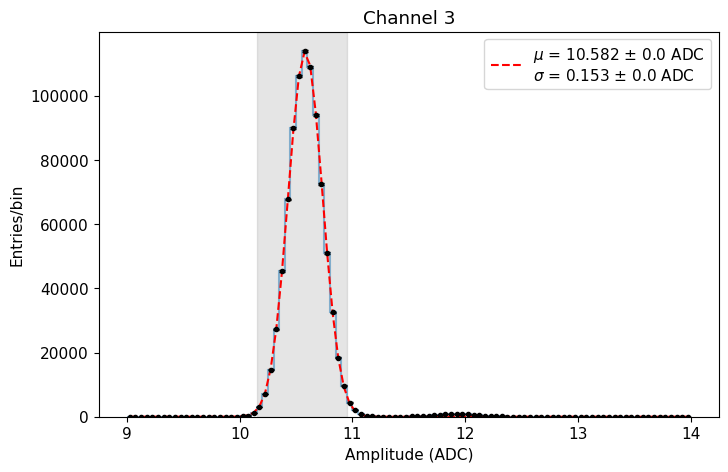

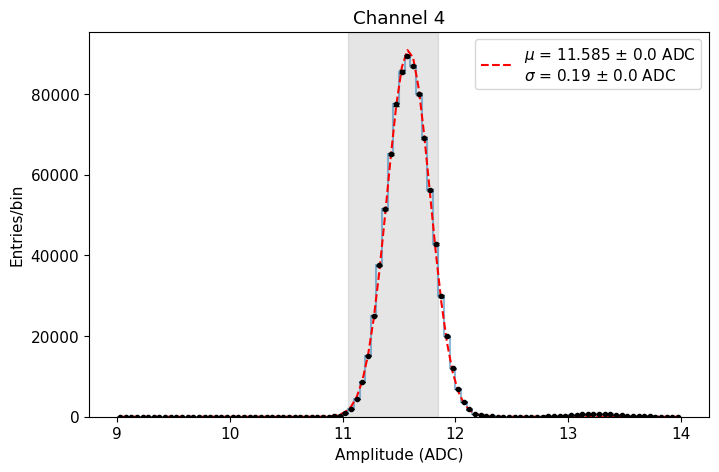

...

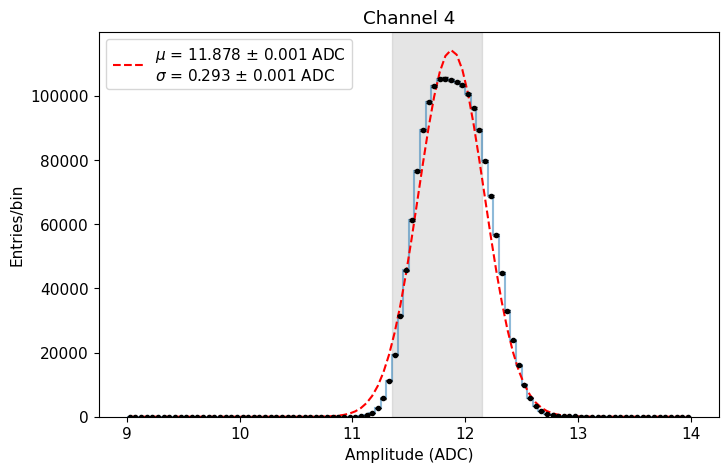

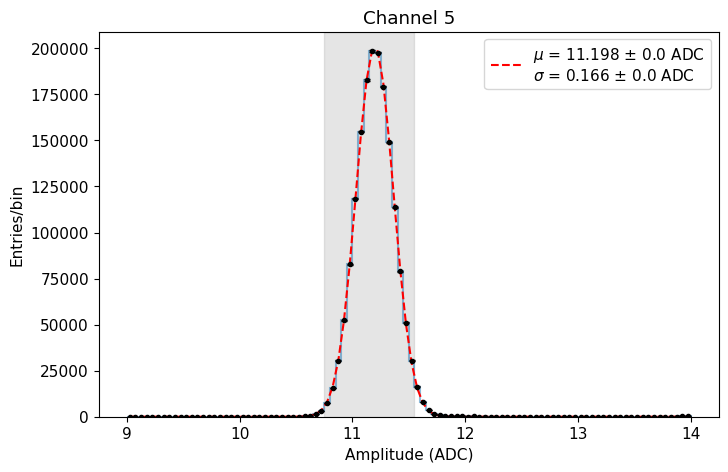

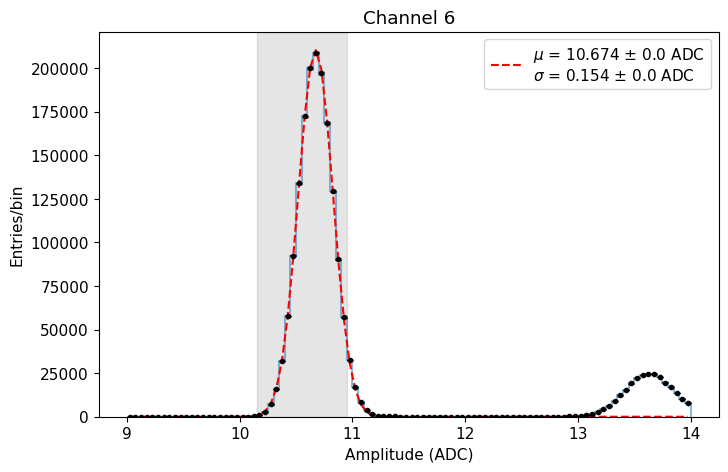

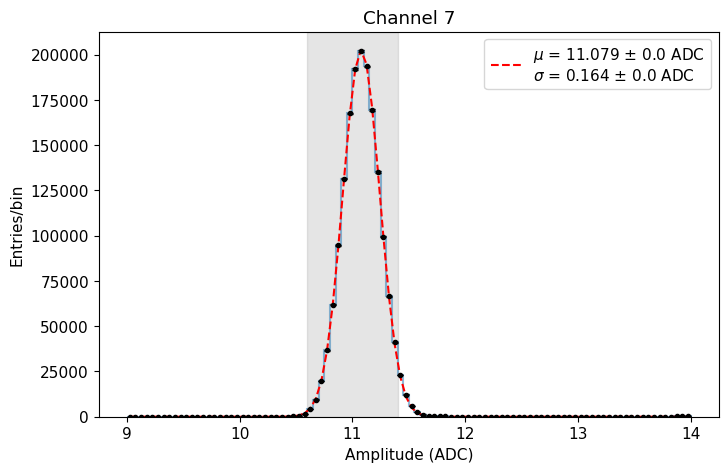

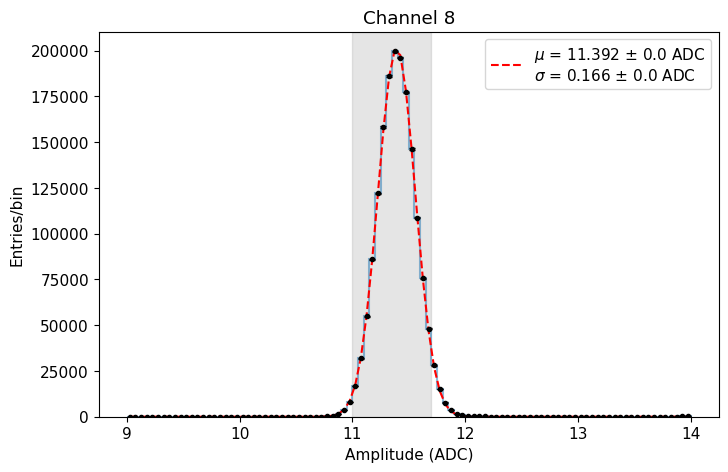

In [64]:
mean_vals = {}
std_vals  = {}
for date in std_all_dict.keys():
    mean_vals_ch = []
    std_vals_ch  = []
    for sipm_ch in range(9):
        counts, bin_edges = np.histogram(std_all_dict[date][sipm_ch], bins=100, range=(5, 20))
        mean_v = bin_edges[np.argmax(counts)]

        if sipm_ch==8 and date in ['12_21_2024', '01_02_2025']:
            fvals = fitf.gaussian_fit_IC(std_all_dict[date][sipm_ch], bins=100, prange=(9, 14), ampl=60000,
                         mean=11, sigma=0.2, frange=(mean_v-0.3, mean_v+0.4), title=f'Channel {sipm_ch}', units='ADC',
                         xlabel='Amplitude (ADC)', print_chi2=False, ndec=3)
        else:
            fvals = fitf.gaussian_fit_IC(std_all_dict[date][sipm_ch], bins=100, prange=(9, 14), ampl=60000,
                             mean=11, sigma=0.2, frange=(mean_v-0.4, mean_v+0.4), title=f'Channel {sipm_ch}', units='ADC',
                             xlabel='Amplitude (ADC)', print_chi2=False, ndec=3)
        mean_vals_ch.append(fvals[0])
        std_vals_ch .append(fvals[2])
    mean_vals[date] = mean_vals_ch
    std_vals [date] = std_vals_ch

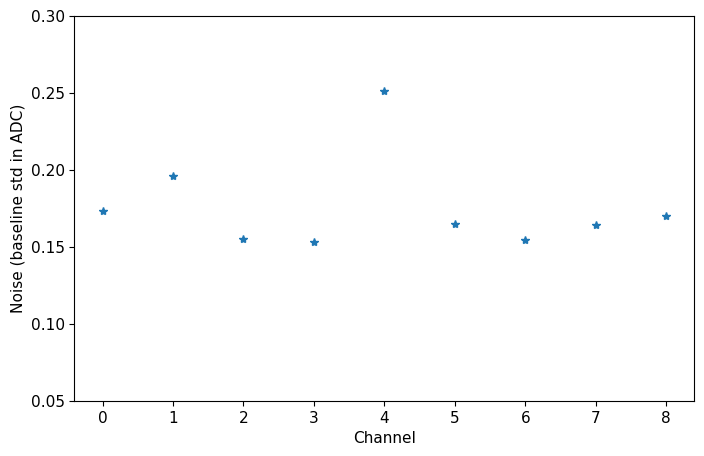

In [65]:
plt.plot(std_vals['10_04_2024'], marker='*', lw=0)
plt.xlabel('Channel')
plt.ylabel('Noise (baseline std in ADC)')
plt.ylim(0.05, 0.3)
plt.show()

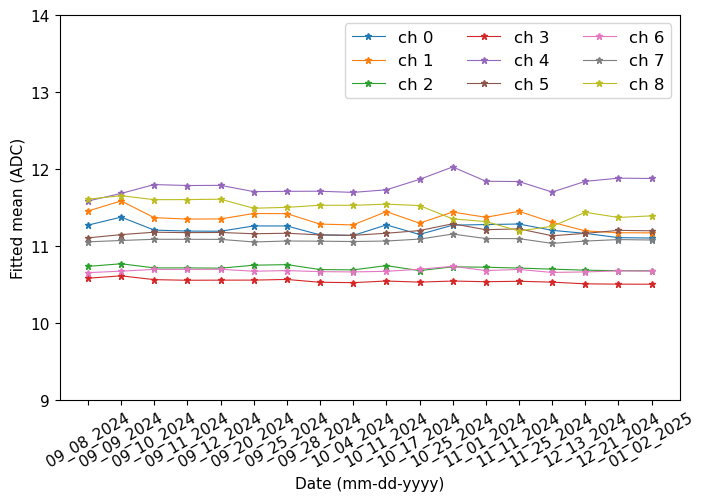

In [66]:
for ch in range(9):
    means = [mean_vals[date][ch] for date in mean_vals.keys()]
    plt.plot([date for date in mean_vals.keys()], means, label=f'ch {ch}', lw=0.8, marker='*', markersize=5)
plt.xticks(rotation=30)
plt.ylim(9, 14)
plt.xlabel('Date (mm-dd-yyyy)')
plt.ylabel('Fitted mean (ADC)')
plt.legend(ncol=3, fontsize=12)
plt.show()

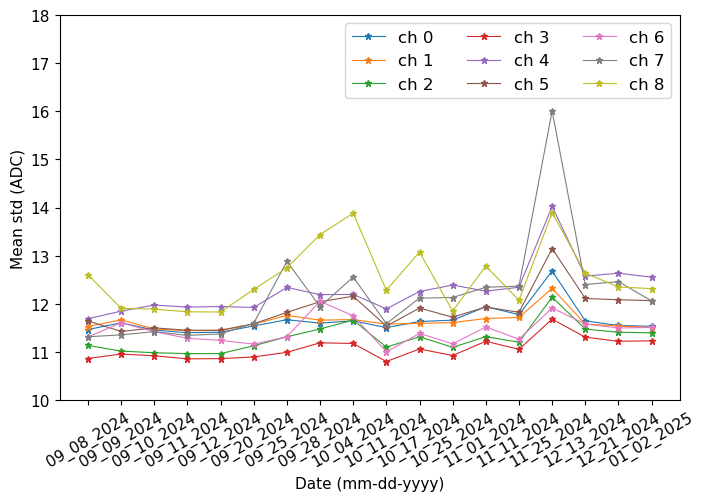

In [68]:
for ch in range(9):
    means_std = [np.mean(std_all_dict[date][ch]) for date in std_all_dict.keys()]
    plt.plot([date for date in std_all_dict.keys()], means_std, label=f'ch {ch}', lw=0.8, marker='*', markersize=5)
plt.xticks(rotation=30)
plt.ylim(10, 18)
plt.xlabel('Date (mm-dd-yyyy)')
plt.ylabel('Mean std (ADC)')
plt.legend(ncol=3, fontsize=12)
plt.show()

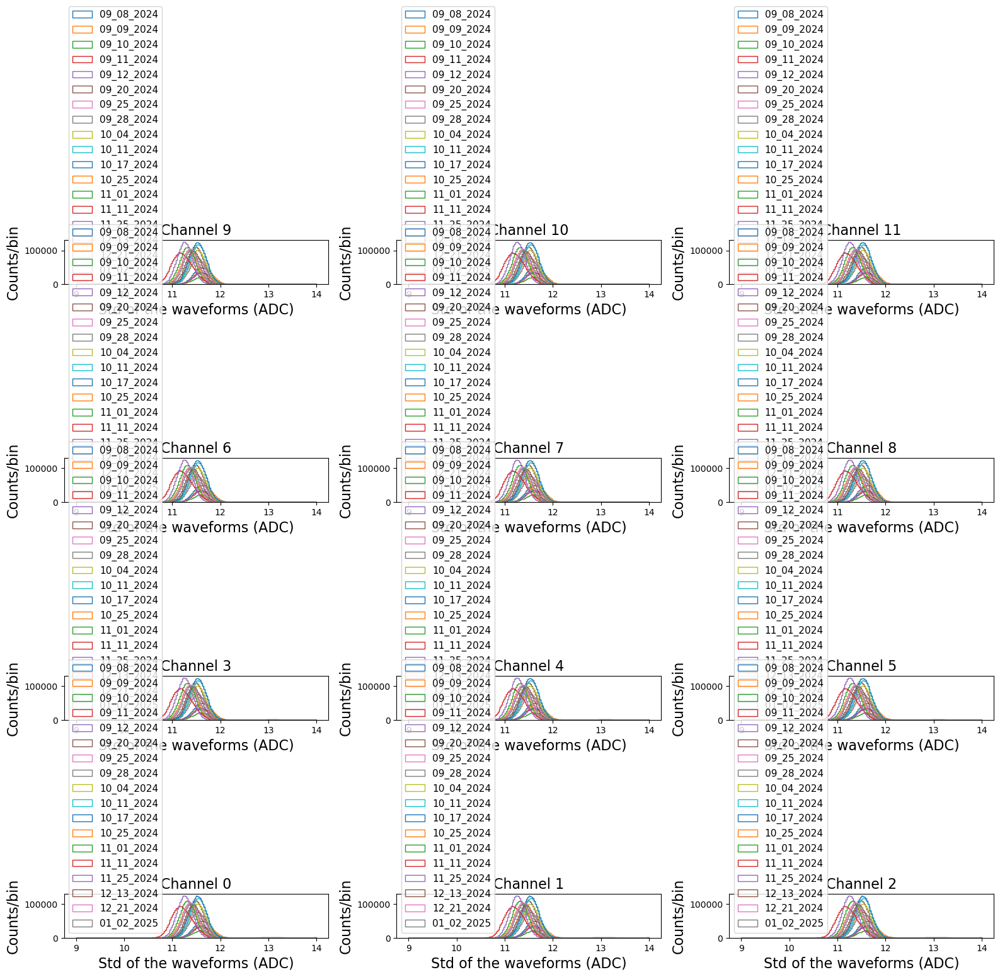

In [69]:
fig, axs = plt.subplots(4, 3, figsize=(16, 14))
for row, ich in enumerate(reversed(np.arange(0, 12, 3))):
    for col in range(3):
        ch = ich + col
        
        for sel_date in std_all_dict.keys():
            axs[row][col].hist(std_all_dict[sel_date][sipm_ch], bins=200, range=(9, 14), label=f'{sel_date}', histtype='step')
        axs[row][col].set_xlabel('Std of the waveforms (ADC)', fontsize=16)
        axs[row][col].set_ylabel('Counts/bin',                 fontsize=16)
        axs[row][col].set_title(f"Channel {ch}",               fontsize=16)
        axs[row][col].tick_params(axis='x', labelsize=10)
        axs[row][col].tick_params(axis='y', labelsize=10)
        axs[row][col].legend()
        
plt.tight_layout()
plt.show()

### Normalize the values to 1 to compare all cases

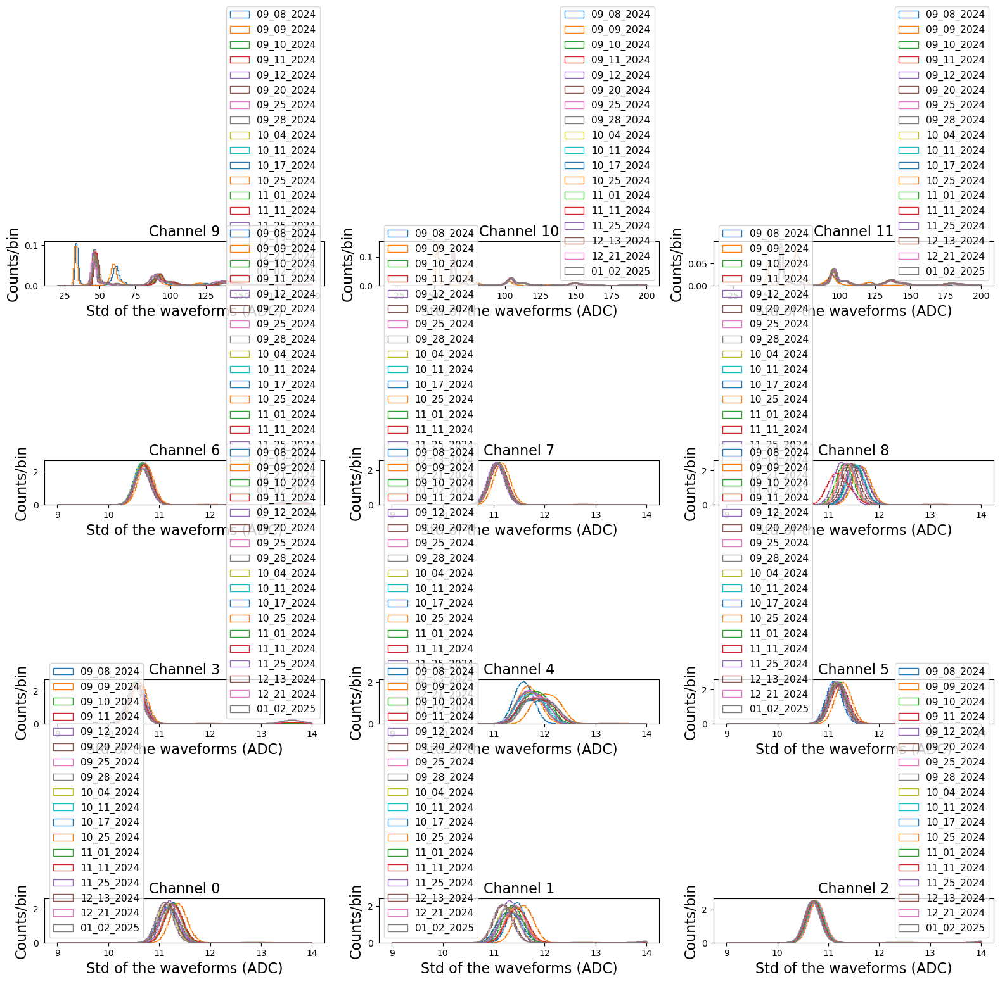

In [70]:
fig, axs   = plt.subplots(4, 3, figsize=(16, 14))
for row, ich in enumerate(reversed(np.arange(0, 12, 3))):
    for col in range(3):
        ch = ich + col
        if ch in [9, 10, 11]:
            prange = (20, 200)
        else:
            prange = (9, 14)
        for sel_date in std_all_dict.keys():
            axs[row][col].hist(std_all_dict[sel_date][ch], bins=200, range=prange, label=f'{sel_date}', histtype='step', density=True)
        axs[row][col].set_xlabel('Std of the waveforms (ADC)', fontsize=16)
        axs[row][col].set_ylabel('Counts/bin',                 fontsize=16)
        axs[row][col].set_title(f"Channel {ch}",               fontsize=16)
        axs[row][col].tick_params(axis='x', labelsize=10)
        axs[row][col].tick_params(axis='y', labelsize=10)
        axs[row][col].legend()
        #axs[row][col].set_xlim(9, 14)
        
plt.tight_layout()
plt.show()

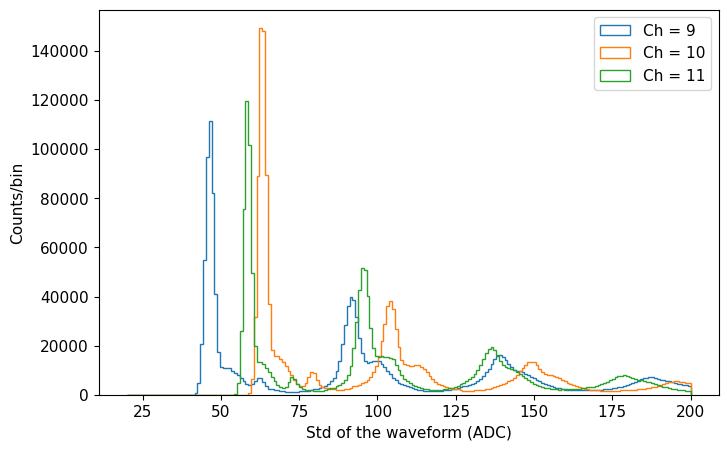

In [71]:
for sipm_ch in [9, 10, 11]:
    plt.hist(std_all_dict['10_04_2024'][sipm_ch], bins=200, range=(20, 200), label=f'Ch = {sipm_ch}', histtype='step')
plt.legend()
plt.xlabel('Std of the waveform (ADC)')
plt.ylabel('Counts/bin')
plt.show()

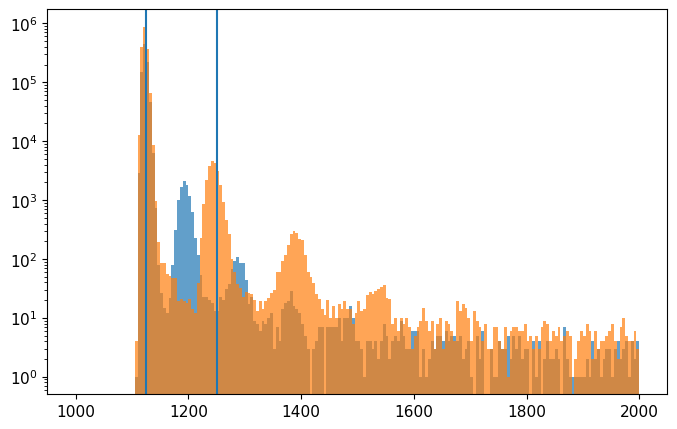

In [72]:
sipm_ch = 0
plt.hist(max_all_dict['09_08_2024'][sipm_ch], bins=200, range=(1000, 2000), log=True, alpha=0.7);
plt.hist(max_all_dict['10_04_2024'][sipm_ch], bins=200, range=(1000, 2000), log=True, alpha=0.7)
plt.axvline(1125)
plt.axvline(1250);

In [73]:
np.unique(bsl_mode_i_dict['09_08_2024'][ch])

array([1152., 1153., 1154., 1155., 1156., 1157., 1158., 1159., 1160.,
       1161., 1162., 1163., 1164.], dtype=float32)

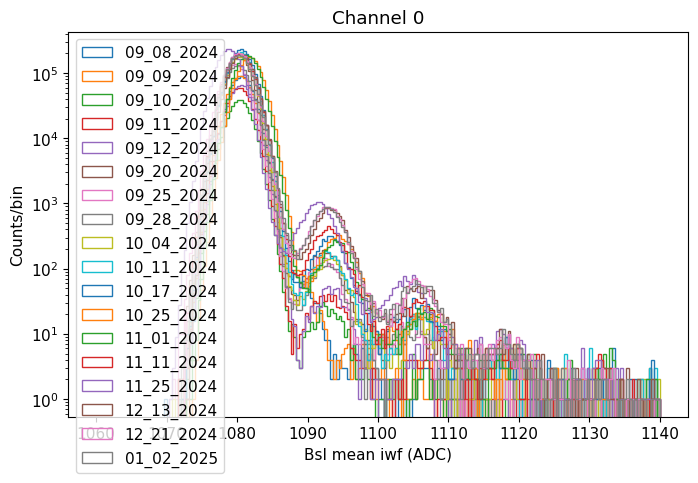

In [74]:
sipm_ch = 0
for sel_date in std_all_dict.keys():
    plt.hist(bsl_mean_i_dict[sel_date][sipm_ch], bins=200, range=(1060, 1140), label=f'{sel_date}', histtype='step', log=True)
plt.legend()
plt.title(f'Channel {sipm_ch}')
plt.xlabel('Bsl mean iwf (ADC)')
plt.ylabel('Counts/bin')
plt.show()

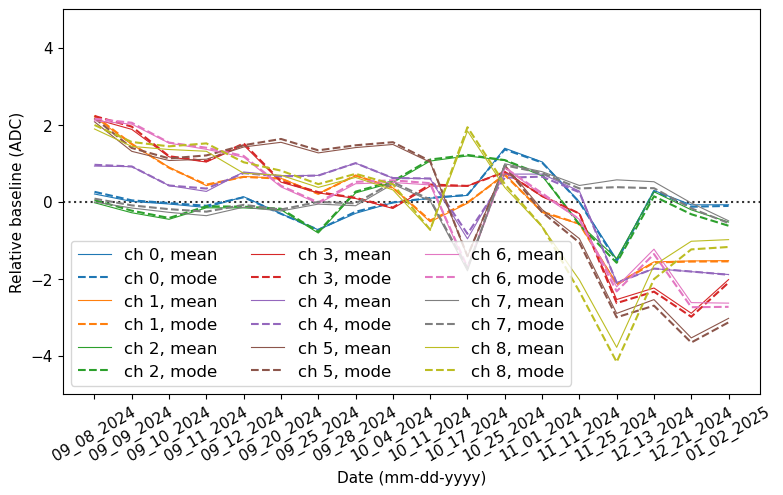

In [77]:
plt.figure(figsize=(9, 5))
plt.axhline(y=0, color='k', ls=':', alpha=0.8)
for i, (ch, col) in enumerate(zip(range(9), plt.rcParams['axes.prop_cycle'].by_key()['color'])):
    means_bsl_i_mean = [np.mean(bsl_mean_i_dict[date][ch]) for date in bsl_mean_i_dict.keys()]
    means_bsl_i_mode = [np.mean(bsl_mode_i_dict[date][ch]) for date in bsl_mode_i_dict.keys()]
    plt.plot([date for date in bsl_mean_i_dict.keys()], means_bsl_i_mean - np.mean(means_bsl_i_mean), c=col, label=f'ch {ch}, mean', lw=0.8)
    plt.plot([date for date in bsl_mode_i_dict.keys()], means_bsl_i_mode - np.mean(means_bsl_i_mode), ls='--', c=col, label=f'ch {ch}, mode')
plt.xticks(rotation=30)
plt.legend(ncol=3, fontsize=12)
plt.ylim(-5, 5)
plt.xlabel('Date (mm-dd-yyyy)')
plt.ylabel('Relative baseline (ADC)')
#plt.savefig('/global/homes/r/romo/BACoN_analysis/Run3/plots/baselines_rel1.pdf', dpi=300, bbox_inches='tight')
plt.show()

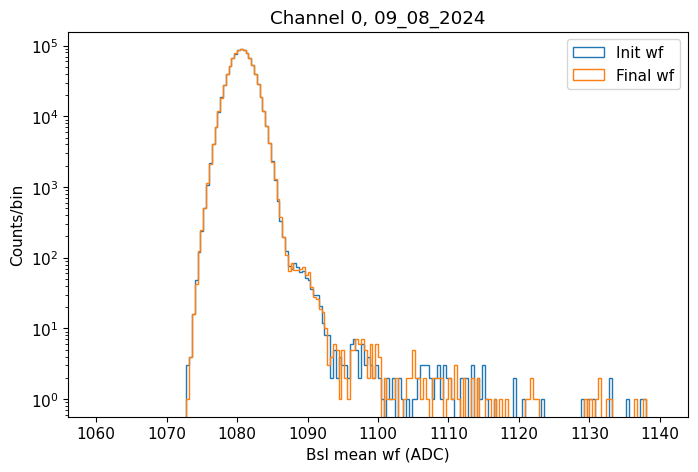

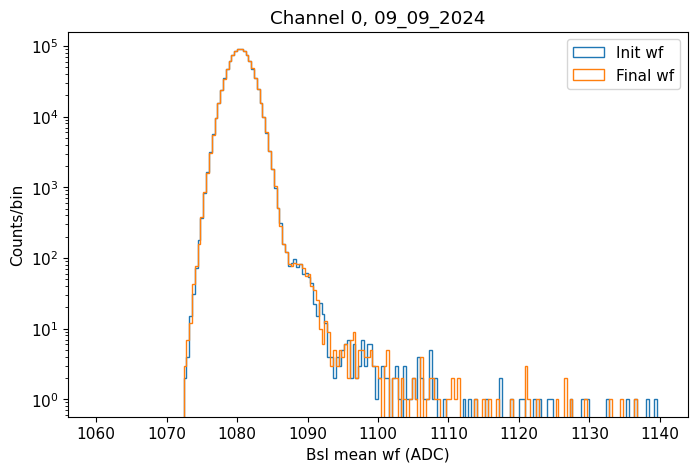

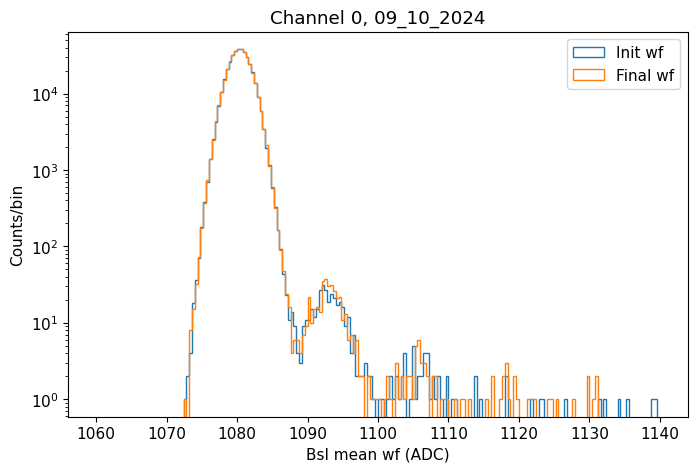

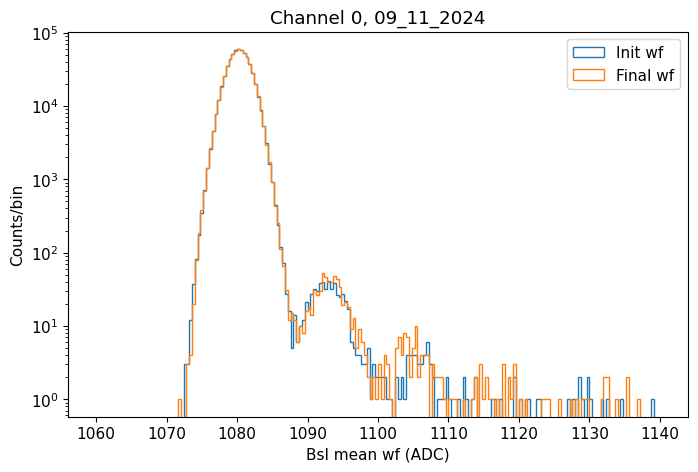

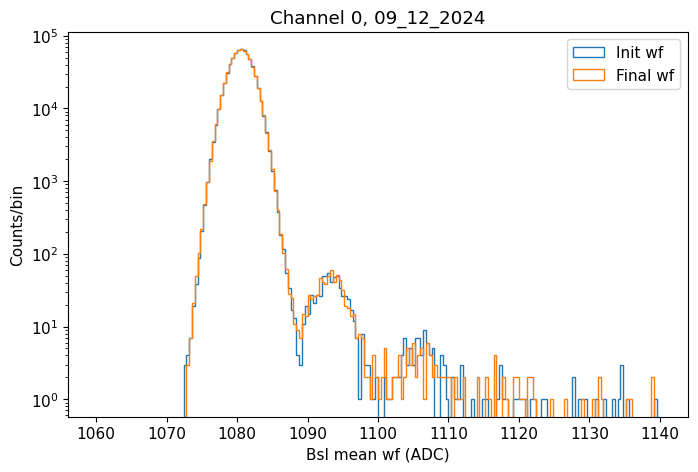

...

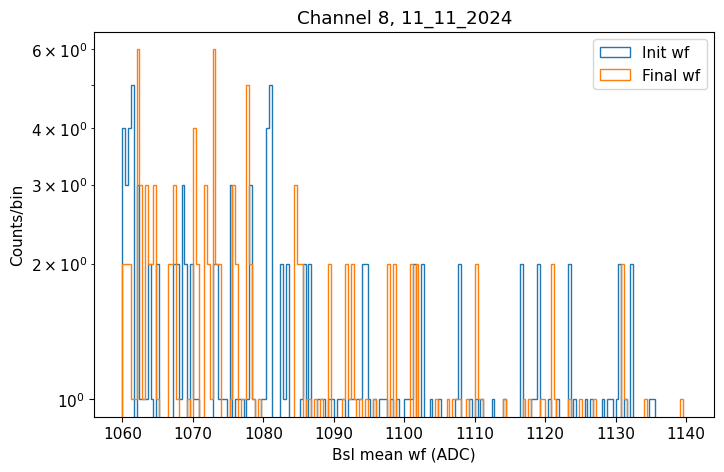

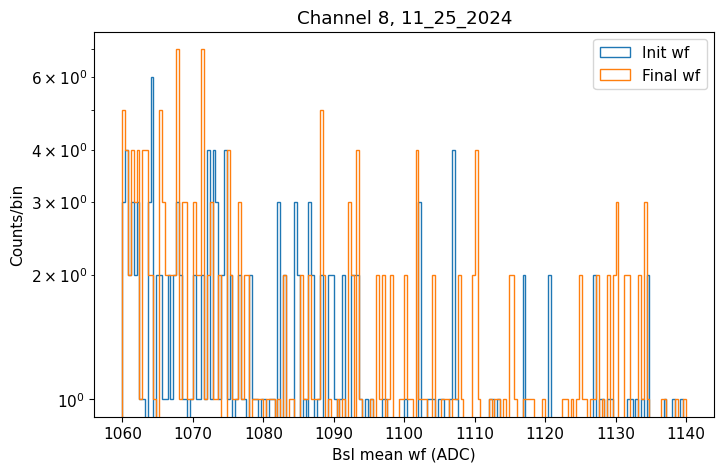

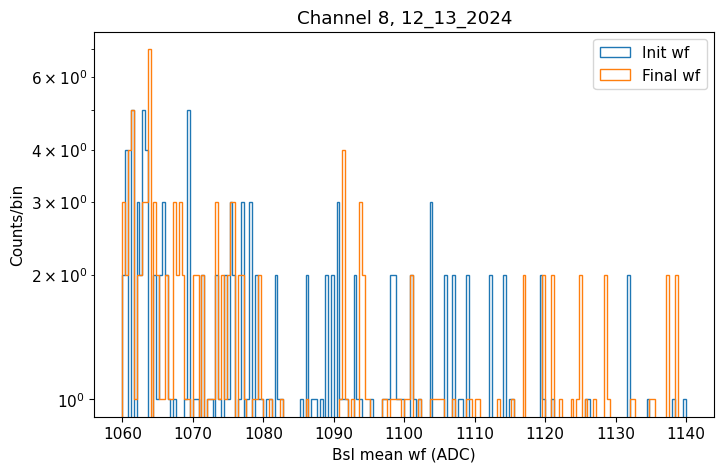

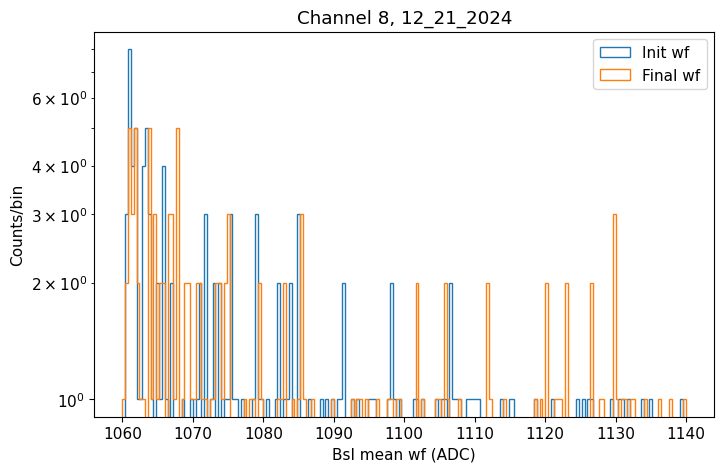

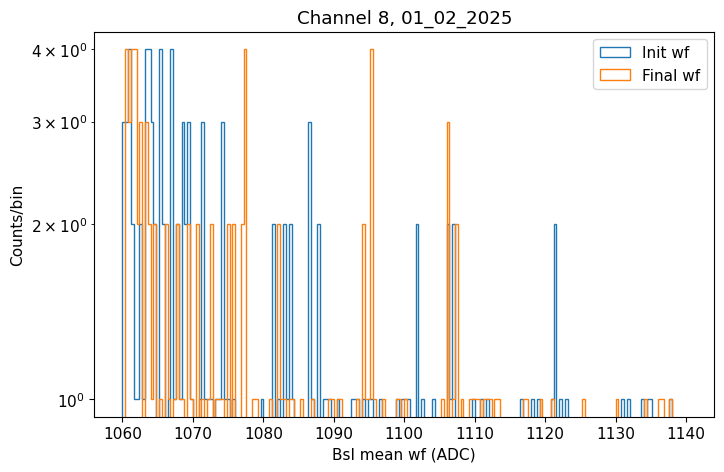

In [78]:
for sipm_ch in range(9):
    for sel_date in std_all_dict.keys():
        plt.hist(bsl_mean_i_dict[sel_date][sipm_ch], bins=200, range=(1060, 1140), label=f'Init wf',  histtype='step', log=True)
        plt.hist(bsl_mean_f_dict[sel_date][sipm_ch], bins=200, range=(1060, 1140), label=f'Final wf', histtype='step', log=True)
        plt.legend()
        plt.title(f'Channel {sipm_ch}, {sel_date}')
        plt.xlabel('Bsl mean wf (ADC)')
        plt.ylabel('Counts/bin')
        plt.show()

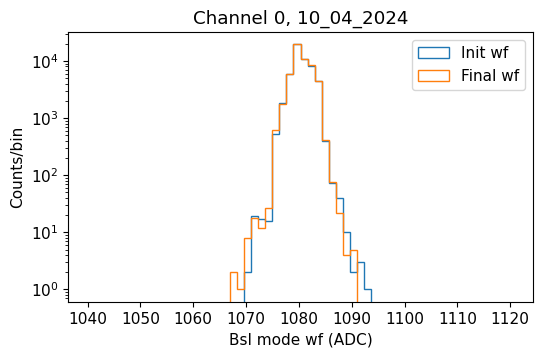

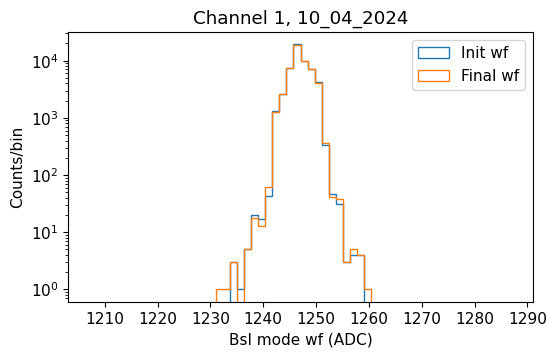

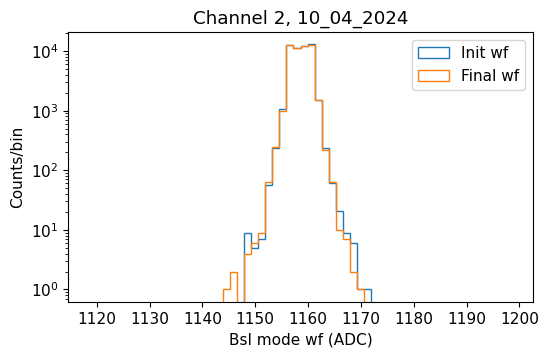

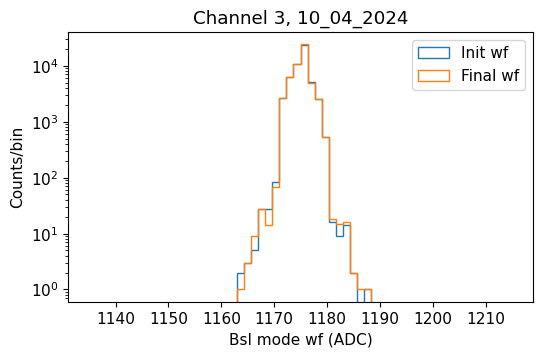

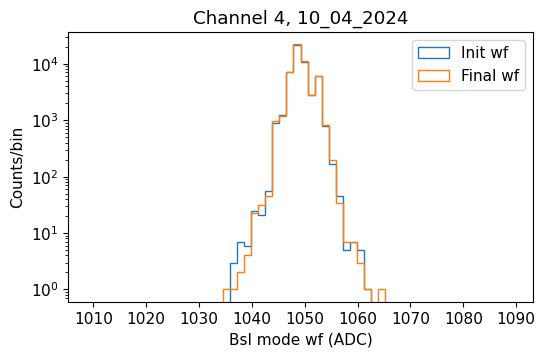

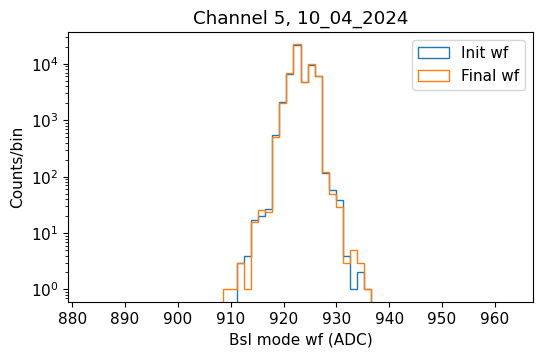

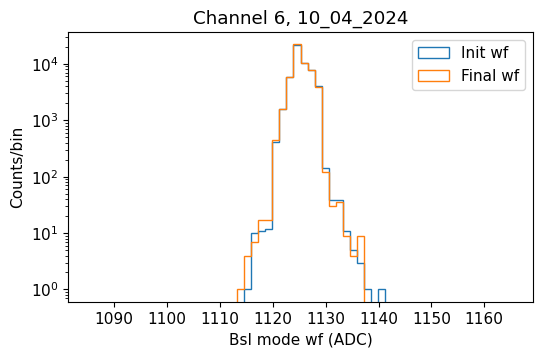

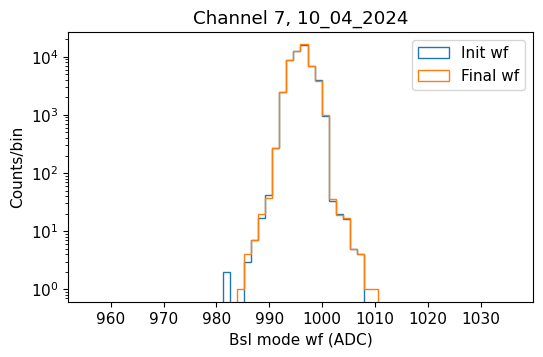

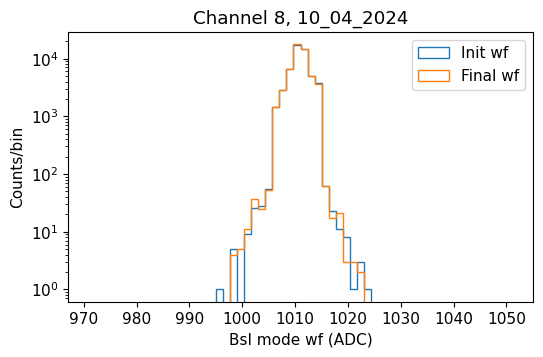

In [79]:
for sipm_ch in range(9):
    for sel_date in std_all_dict.keys():
        if sel_date!='10_04_2024':
            continue
        mean_mode_val = np.mean(bsl_mode_i_dict[sel_date][sipm_ch])
        e_range = mean_mode_val-40, mean_mode_val+40
        plt.figure(figsize=(6, 3.5))
        plt.hist(bsl_mode_i_dict[sel_date][sipm_ch], bins=60, range=e_range, label=f'Init wf',  histtype='step', log=True)
        plt.hist(bsl_mode_f_dict[sel_date][sipm_ch], bins=60, range=e_range, label=f'Final wf', histtype='step', log=True)
        plt.legend()
        plt.title(f'Channel {sipm_ch}, {sel_date}')
        plt.xlabel('Bsl mode wf (ADC)')
        plt.ylabel('Counts/bin')
        plt.show()

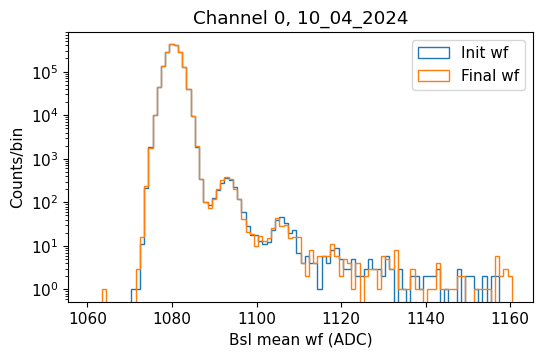

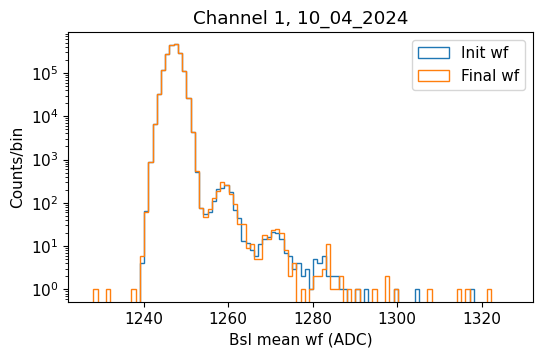

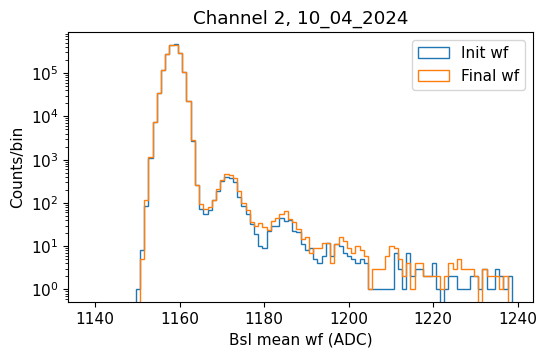

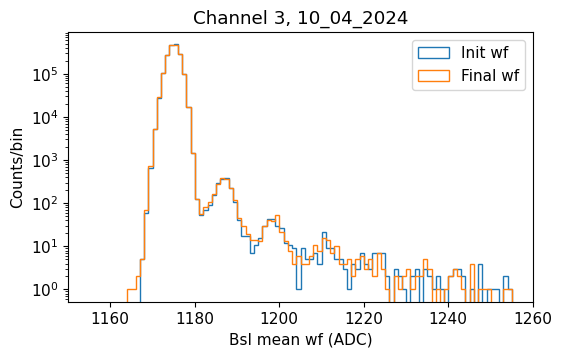

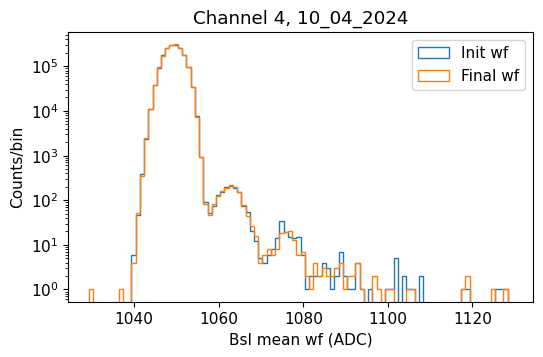

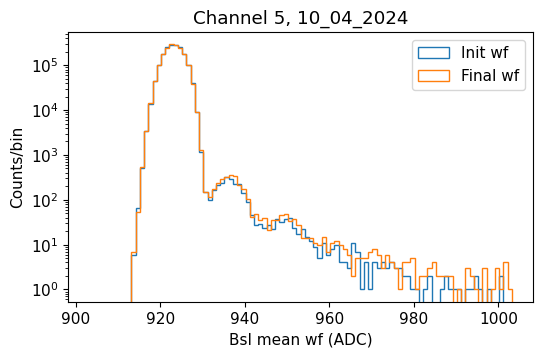

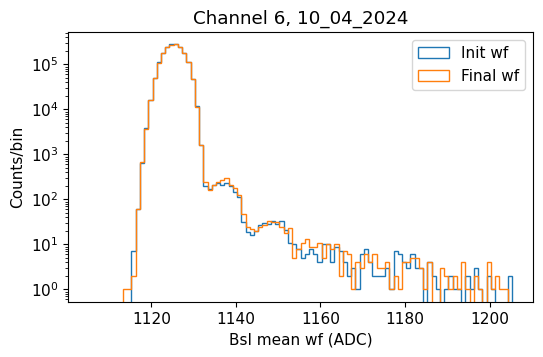

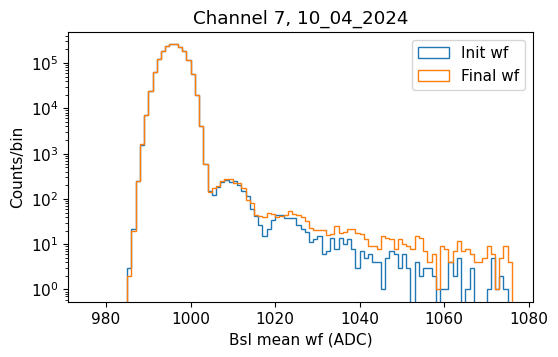

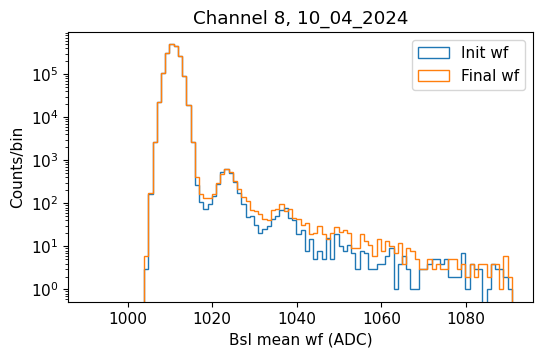

In [80]:
for sipm_ch in range(9):
    for sel_date in std_all_dict.keys():
        if sel_date!='10_04_2024':
            continue
        mean_mean_val = np.mean(bsl_mean_i_dict[sel_date][sipm_ch])
        e_range = mean_mean_val-20, mean_mean_val+80
        plt.figure(figsize=(6, 3.5))
        plt.hist(bsl_mean_i_dict[sel_date][sipm_ch], bins=100, range=e_range, label=f'Init wf',  histtype='step', log=True)
        plt.hist(bsl_mean_f_dict[sel_date][sipm_ch], bins=100, range=e_range, label=f'Final wf', histtype='step', log=True)
        plt.legend()
        plt.title(f'Channel {sipm_ch}, {sel_date}')
        plt.xlabel('Bsl mean wf (ADC)')
        plt.ylabel('Counts/bin')
        plt.show()

## hist2d with baseline values at beginning and end of wf

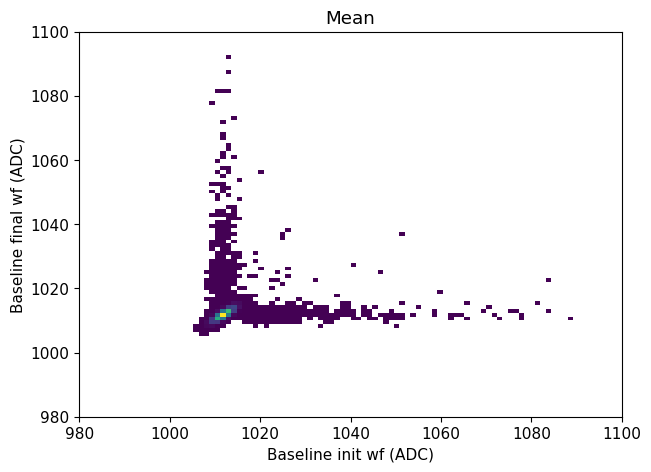

In [121]:
sel_ch   = 8
sel_date = '09_10_2024'

plt.figure(figsize=(7, 5))
plt.hist2d(bsl_mean_i_dict[sel_date][sel_ch], bsl_mean_f_dict[sel_date][sel_ch], bins=(100, 100), cmin=1, range=((980, 1100), (980, 1100)))
plt.xlabel('Baseline init wf (ADC)')
plt.ylabel('Baseline final wf (ADC)')
plt.title('Mean')
plt.show()

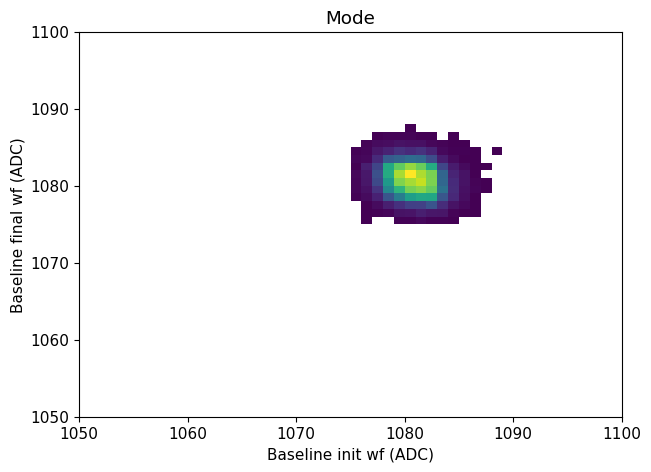

In [82]:
sel_ch   = 0
sel_date = '09_10_2024'

plt.figure(figsize=(7, 5))
plt.hist2d(bsl_mode_i_dict[sel_date][sel_ch], bsl_mode_f_dict[sel_date][sel_ch], bins=(50, 50), cmin=1, range=((1050, 1100), (1050, 1100)))
plt.xlabel('Baseline init wf (ADC)')
plt.ylabel('Baseline final wf (ADC)')
plt.title('Mode')
plt.show()

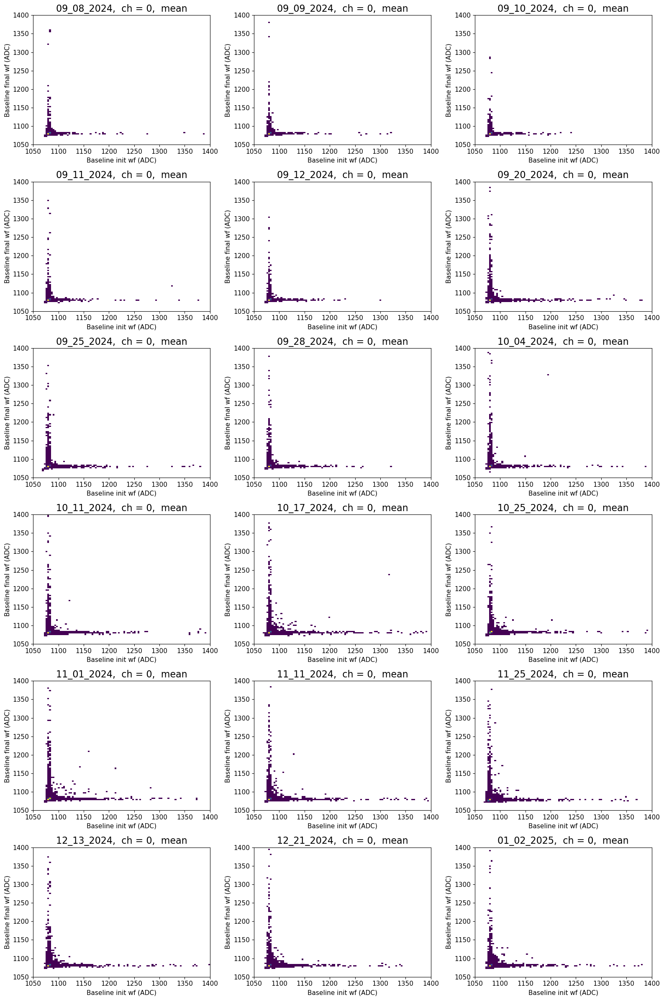

In [83]:
sel_ch    = 0
num_cols  = 3
num_plots = len(bsl_mean_i_dict.keys())
num_rows  = int(np.ceil(num_plots/num_cols))

fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 24))

for i,date in enumerate(bsl_mean_i_dict.keys()):
    irow = i // num_cols
    icol = i % num_cols
    
    axs[irow][icol].hist2d(bsl_mean_i_dict[date][sel_ch], bsl_mean_f_dict[date][sel_ch], bins=(100, 100), range=((1050, 1400), (1050, 1400)), cmin=1)
    axs[irow][icol].set_title(f"{date},  ch = {sel_ch},  mean", fontsize=16)
    axs[irow][icol].set_xlabel('Baseline init wf (ADC)')
    axs[irow][icol].set_ylabel('Baseline final wf (ADC)')

plt.tight_layout()
plt.show()


In [139]:
ranges_ch = {0: (1070, 1120),
             1: (1230, 1280),
             2: (1140, 1210),
             3: (1160, 1220),
             4: (1030, 1100),
             5: ( 900,  980),
             6: (1110, 1180),
             7: ( 980, 1060),
             8: ( 990, 1080)}

ranges2_ch = {0: (1060, 1100),
              1: (1230, 1270),
              2: (1140, 1180),
              3: (1160, 1200),
              4: (1030, 1070),
              5: ( 900,  940),
              6: (1110, 1150),
              7: ( 980, 1020),
              8: ( 990, 1030)}

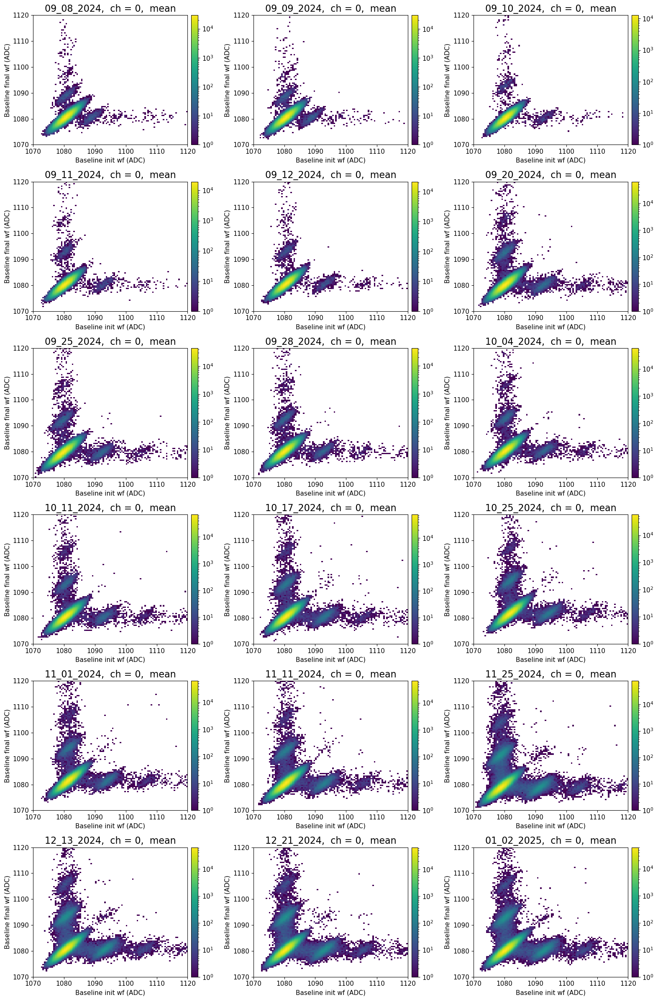

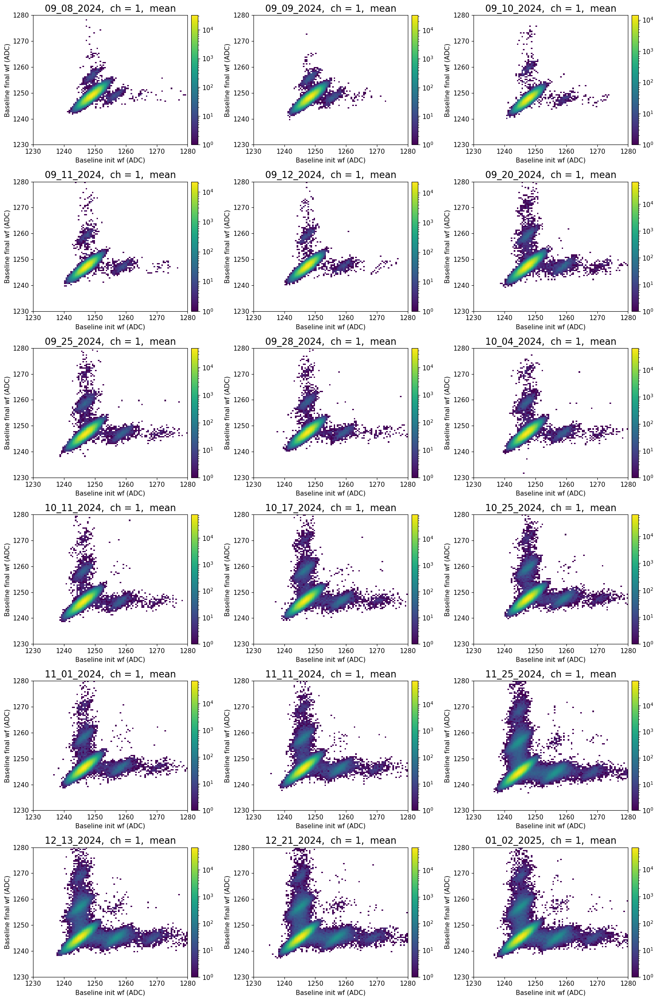

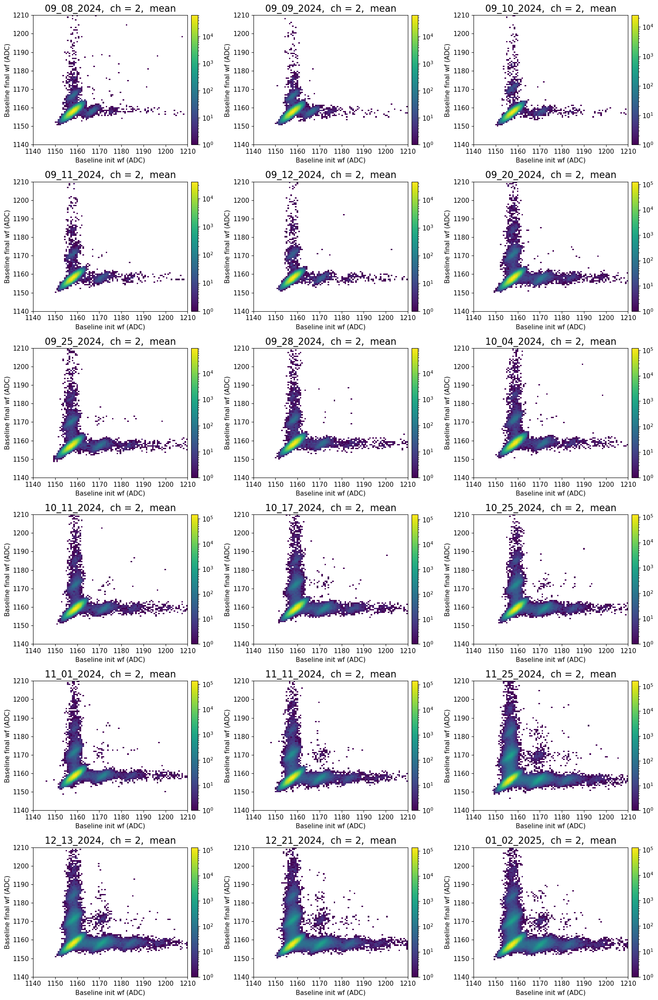

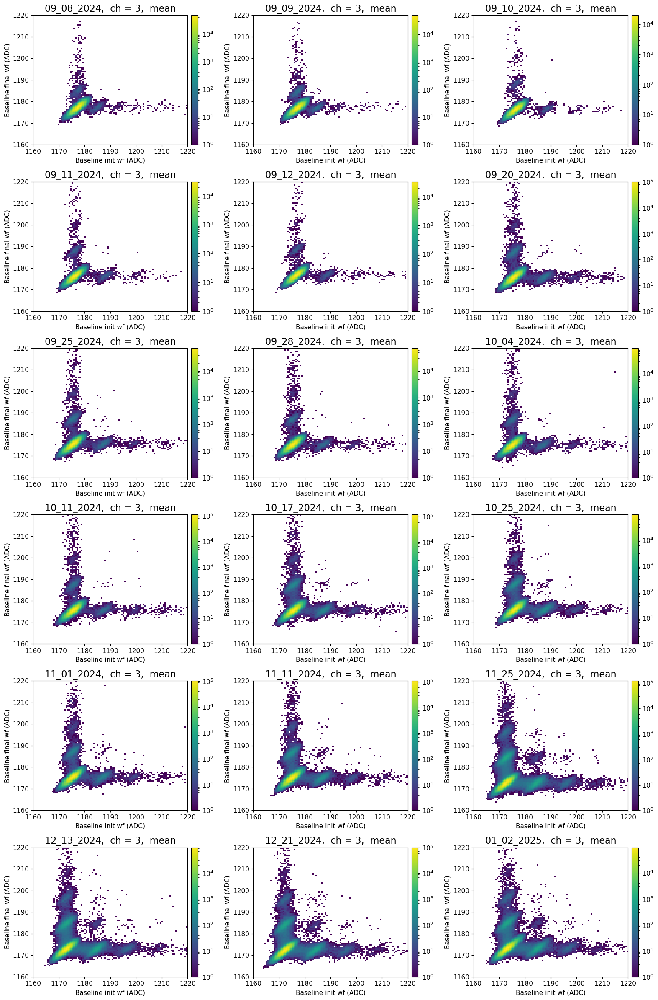

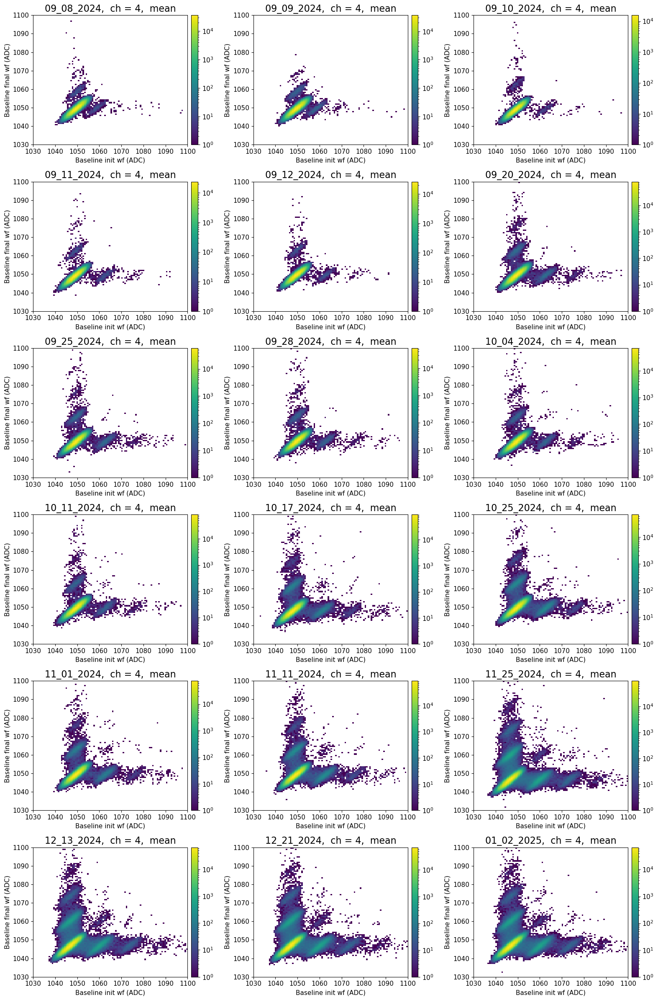

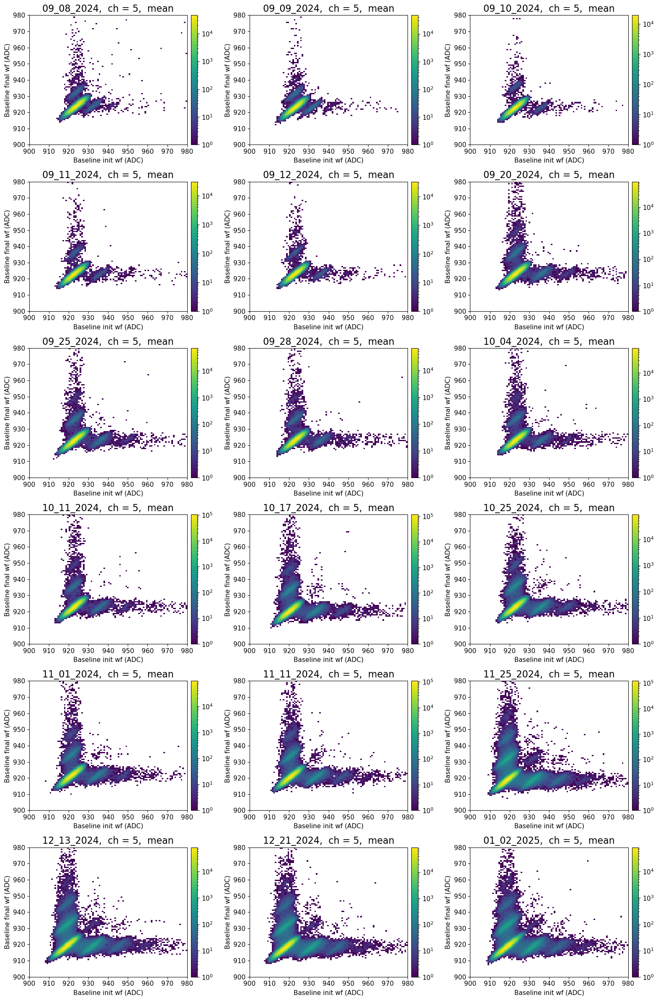

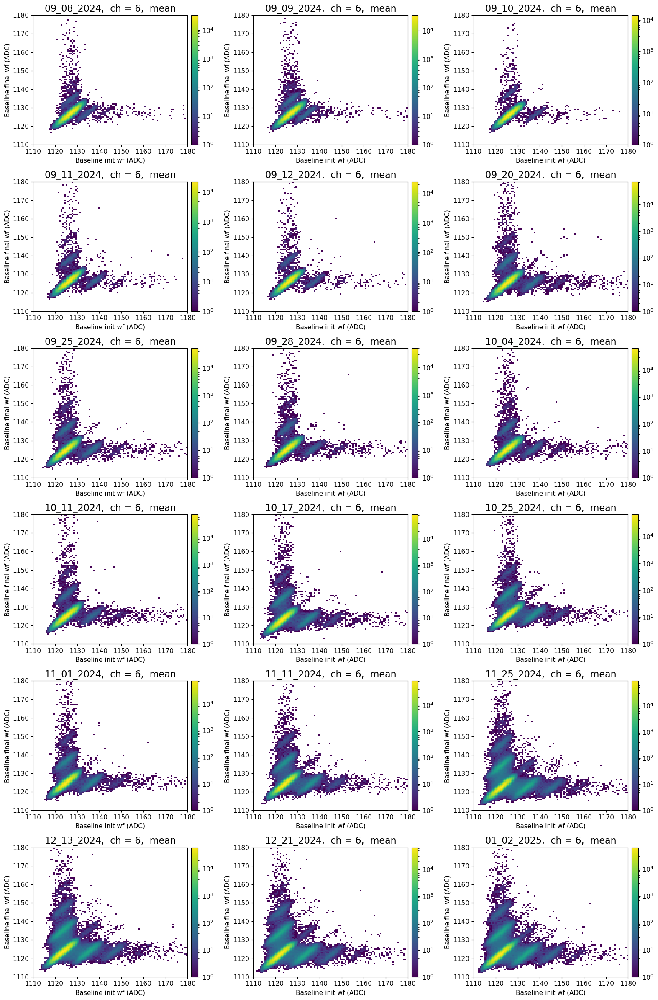

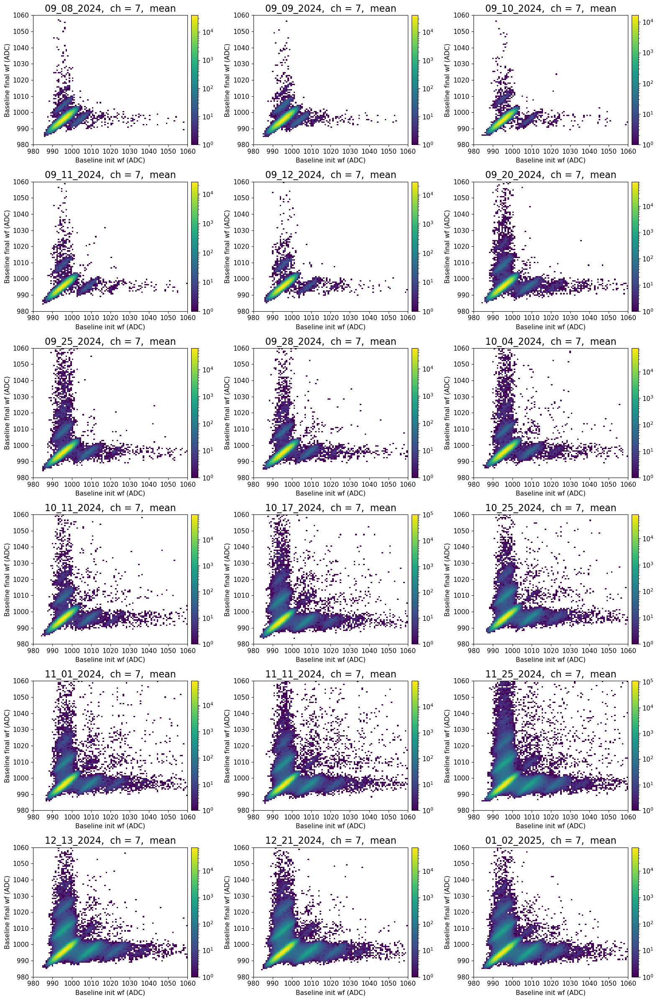

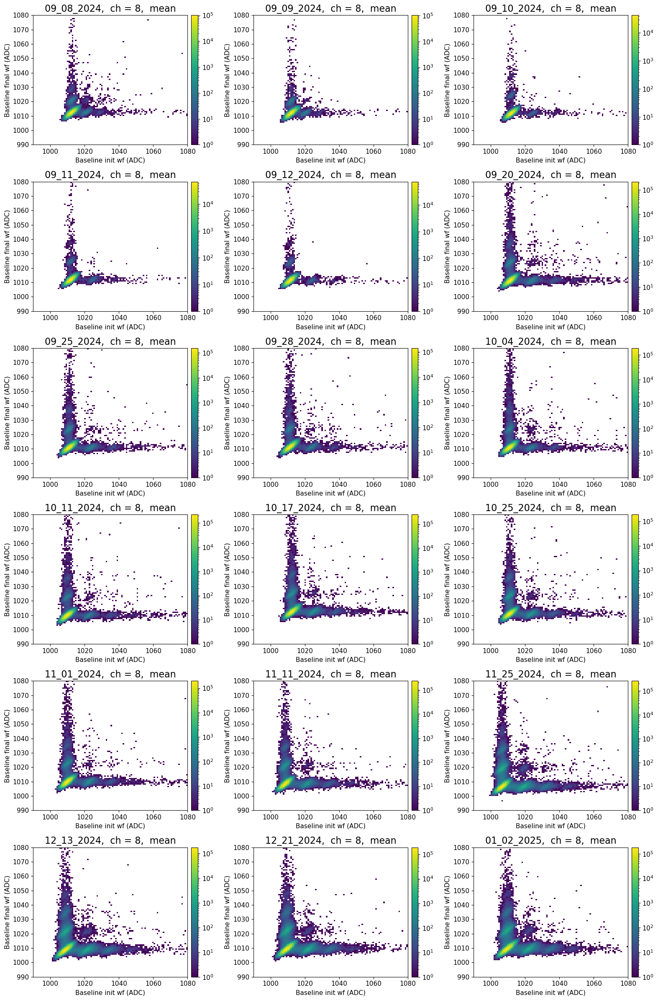

In [136]:
num_cols  = 3
num_plots = len(bsl_mean_i_dict.keys())
num_rows  = int(np.ceil(num_plots/num_cols))

for sel_ch in range(9):
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 24))
    
    for i,date in enumerate(bsl_mean_i_dict.keys()):
        irow = i // num_cols
        icol = i % num_cols
        rng  = (ranges_ch[sel_ch], ranges_ch[sel_ch])
        fig0 = axs[irow][icol].hist2d(bsl_mean_i_dict[date][sel_ch], bsl_mean_f_dict[date][sel_ch], bins=(100, 100), range=rng, cmin=1, norm=LogNorm())
        axs[irow][icol].set_title(f"{date},  ch = {sel_ch},  mean", fontsize=16)
        axs[irow][icol].set_xlabel('Baseline init wf (ADC)')
        axs[irow][icol].set_ylabel('Baseline final wf (ADC)')
        fig.colorbar(fig0[3], ax=axs[irow][icol], pad=0.02)
    
    plt.tight_layout()
    plt.show()


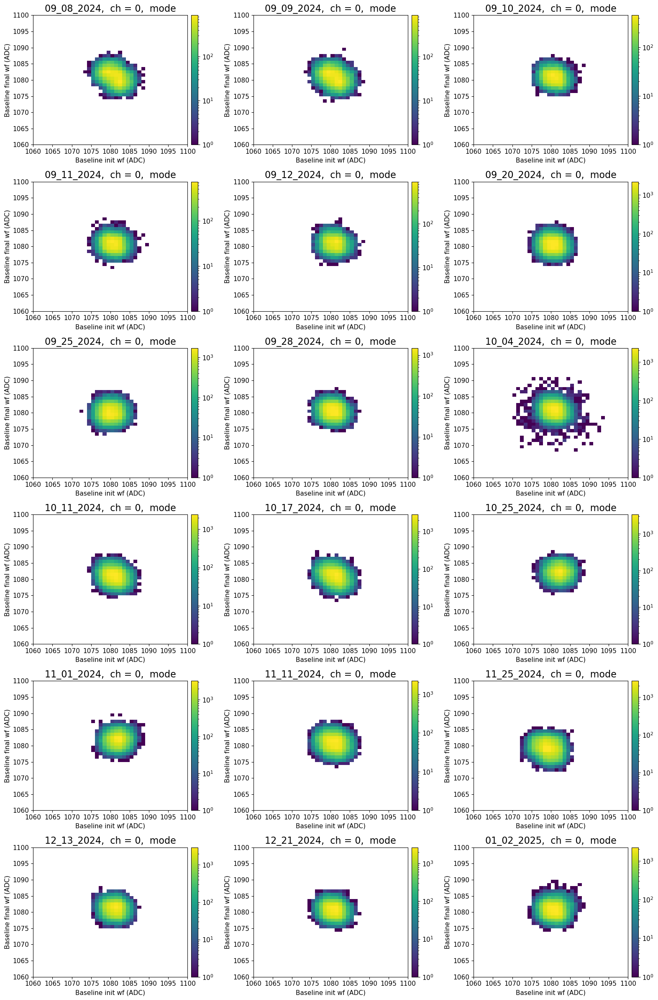

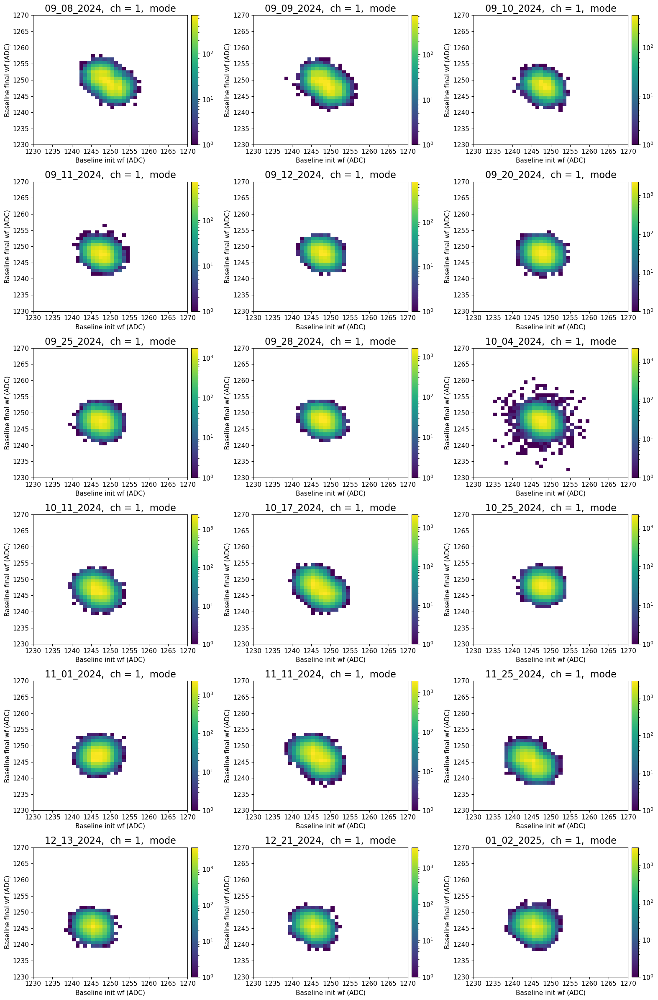

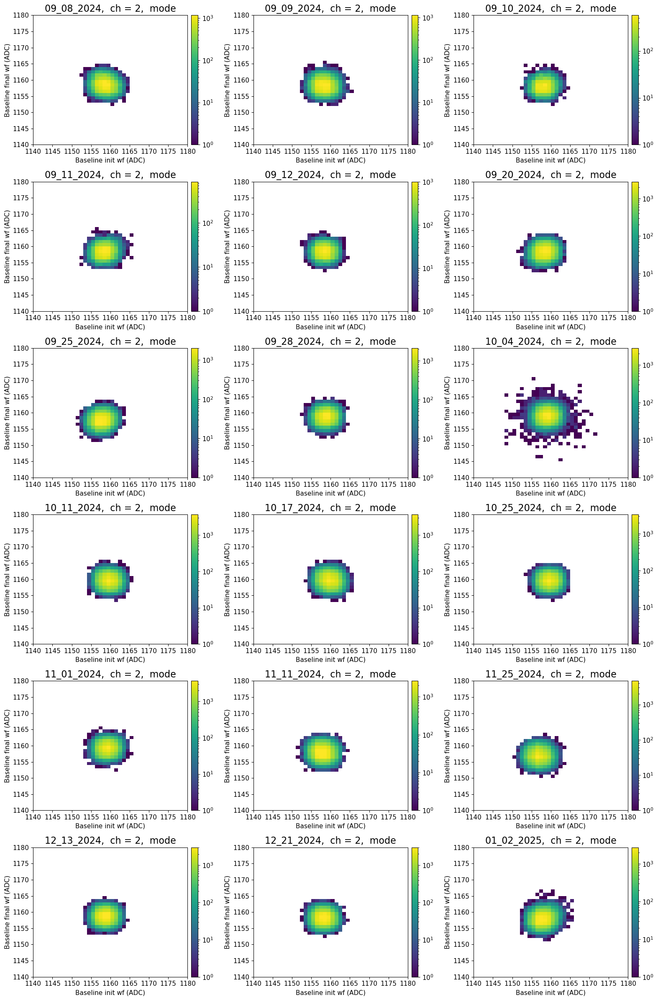

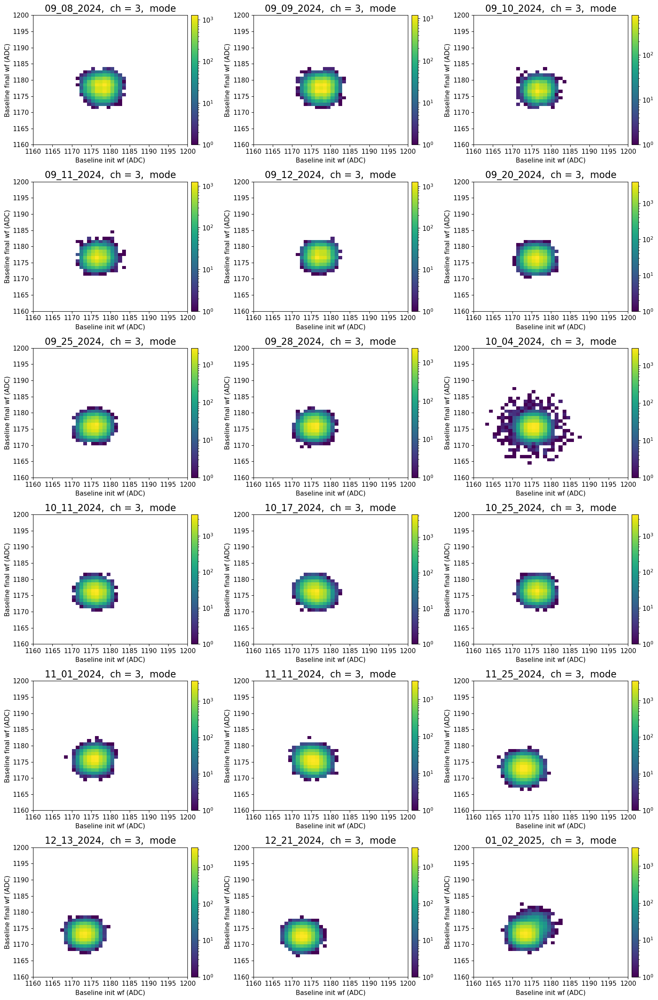

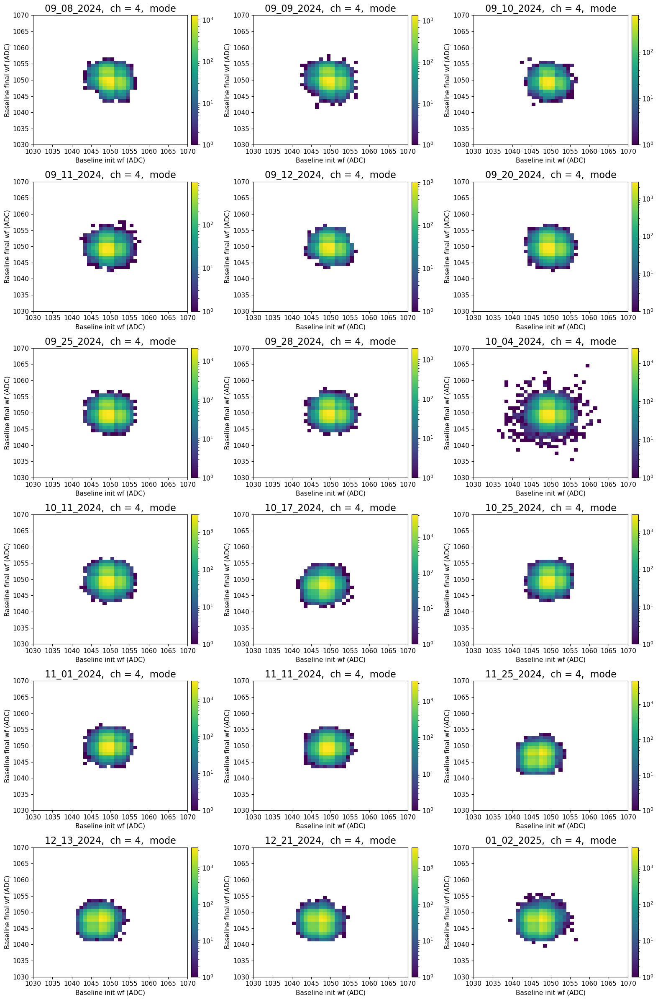

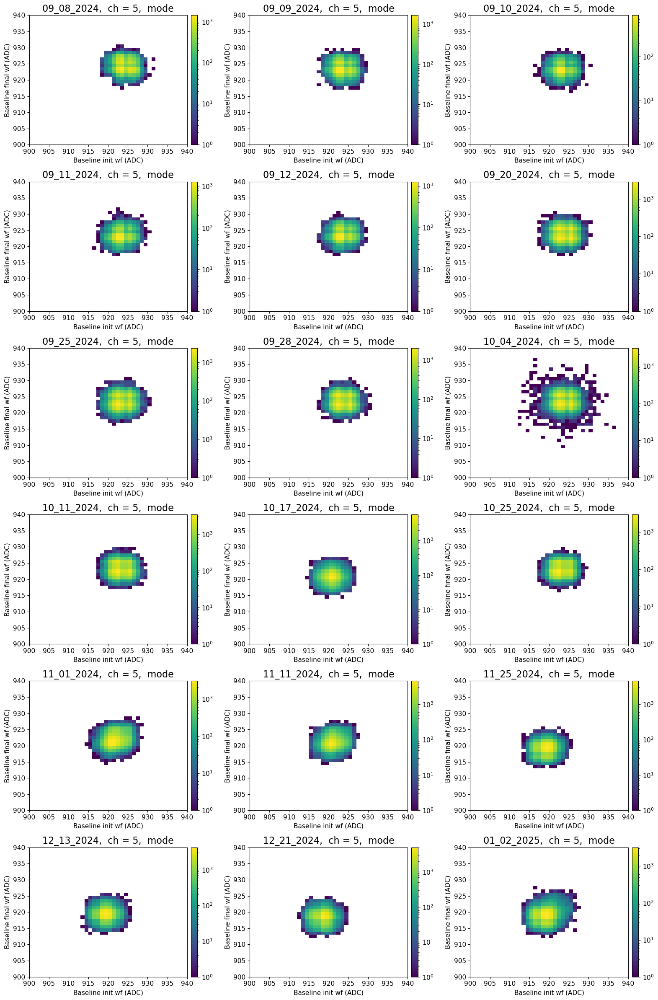

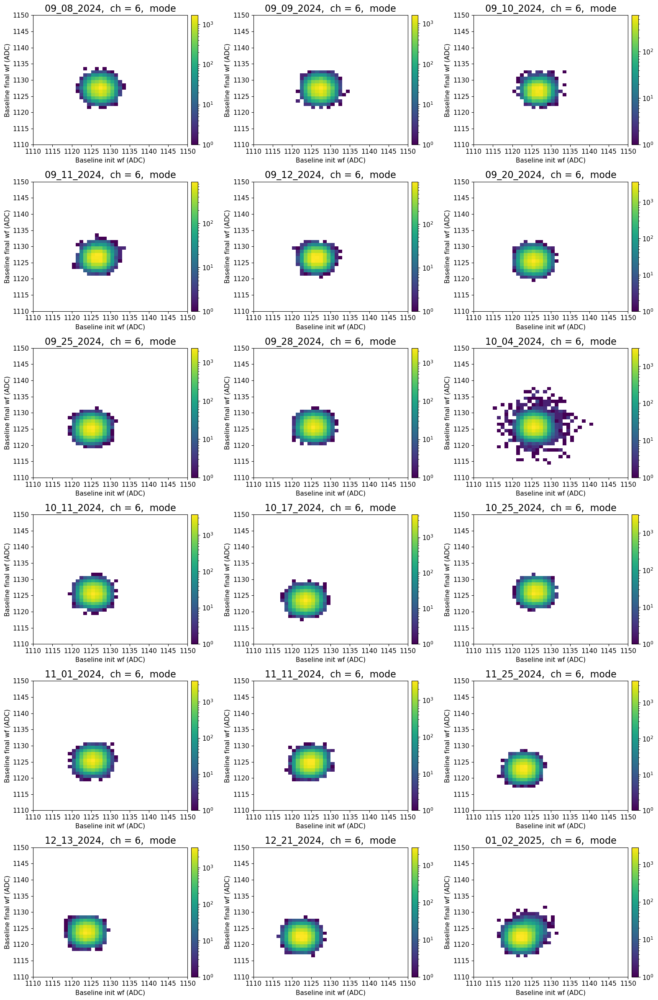

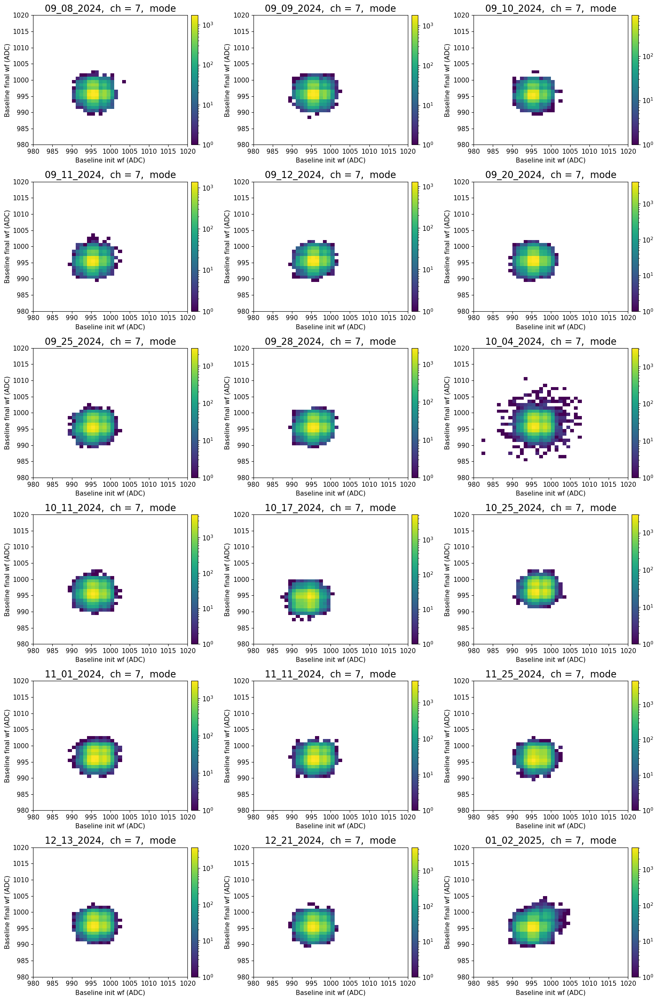

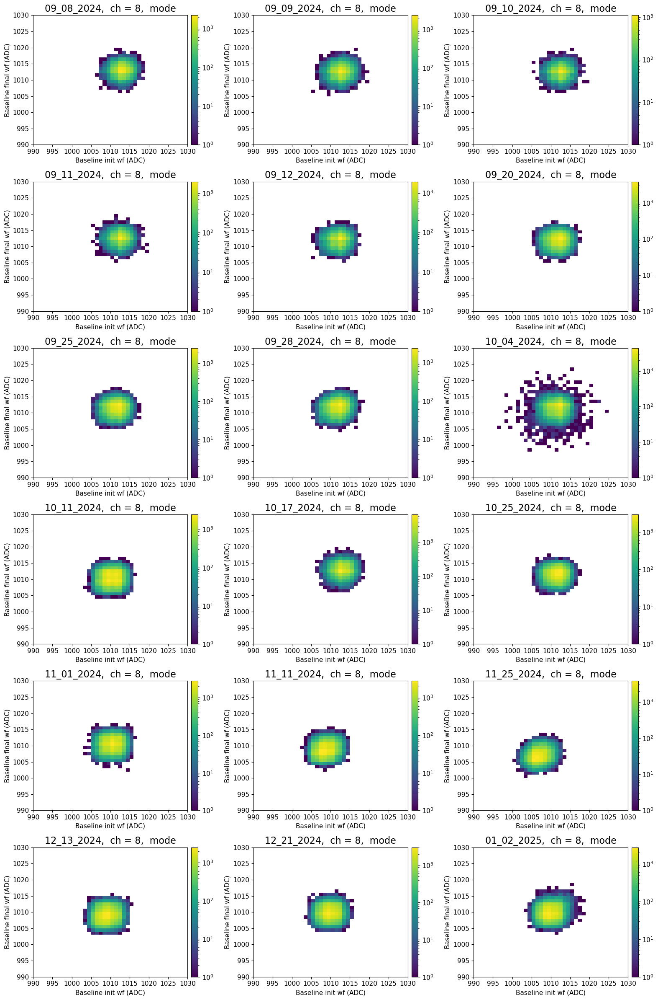

In [140]:
num_cols  = 3
num_plots = len(bsl_mode_i_dict.keys())
num_rows  = int(np.ceil(num_plots/num_cols))

for sel_ch in range(9):
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 24))
    
    for i,date in enumerate(bsl_mean_i_dict.keys()):
        irow = i // num_cols
        icol = i % num_cols
        rng  = (ranges2_ch[sel_ch], ranges2_ch[sel_ch])
        fig0 = axs[irow][icol].hist2d(bsl_mode_i_dict[date][sel_ch], bsl_mode_f_dict[date][sel_ch], bins=(40, 40), range=rng, cmin=1, norm=LogNorm())
        axs[irow][icol].set_title(f"{date},  ch = {sel_ch},  mode", fontsize=16)
        axs[irow][icol].set_xlabel('Baseline init wf (ADC)')
        axs[irow][icol].set_ylabel('Baseline final wf (ADC)')
        fig.colorbar(fig0[3], ax=axs[irow][icol], pad=0.02)
    
    plt.tight_layout()
    plt.show()